In [1]:
from PIL import Image
import torch
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torchvision.transforms import ToTensor, ToPILImage
from torchvision.utils import save_image
from TrainingDataArrangement import arrange_data
from torchvision.transforms import v2
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import matplotlib.pyplot as plt
import os
import numpy as np
import CustomDataset
from UNetModel import UNet
import albumentations as A
from albumentations.pytorch import ToTensorV2

#defining device
device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

Using cuda device


Target path already exists. Please delete it first if you want to re-arrange the data, exiting...
Target path already exists. Please delete it first if you want to re-arrange the data, exiting...
###############ATENCAO###### FAZER O OVERLAY DE IMAGEM E MASCARAS, REFATORAR CÓDIGO ## FAZER UM TXT PARA O PATH DE IMAGENS, E FAZER UMA VERIFICAÇÃO TODO TREINAMENTO PARA OS PATHS INCLUSOS, OU SEJA, CRIAR OUTRO TXT E COMPARAR COM O ATUAL, DELETAR CASO FOR DIFERENTE E CRIAR UMA NOVA APPENDED FOLDER
Showing images: True
Getting the images
Converting images to tensors


C:\Users\Gabriel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\pydantic\main.py:347: UserWarning: Pydantic serializer warnings:
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  return self.__pydantic_serializer__.to_python(
C:\Users\Gabriel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\albumentations\core\validation.py:39: UserWarning: This augmenter is very slow. Try to use ``ElasticTransformation`` instead, which is at least 10x faster.
  original_init(self, **validate

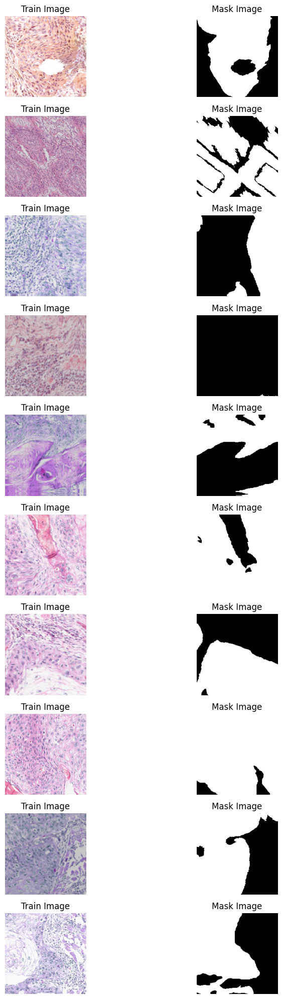

In [2]:
#getting path references
testing_folders = [
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009009\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009010x1000902\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009011\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009014\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009016x1000903\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009023\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009009\02-non_roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009010x1000902\02-non_roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009011\02-non_roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009014\02-non_roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009016x1000903\02-non_roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\testing\tumor\patch\640x640\1009023\02-non_roi"
]

training_folders = [
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009009\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009010x1000902\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009011\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009014\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009016x1000903\01-roi",
    r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009023\01-roi",
    # r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009009\02-non_roi",
    # r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009010x1000902\02-non_roi",
    # r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009011\02-non_roi",
    # r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009014\02-non_roi",
    # r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009016x1000903\02-non_roi",
    # r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\training\tumor\patch\640x640\1009023\02-non_roi"
]

updated_training_folders = []
updated_testing_folders = []

for training_folder, testing_folder in zip(training_folders, testing_folders):
    original_training_folder = training_folder + "\\01-original"
    mask_training_folder = training_folder + "\\02-mask"
    updated_training_folders.extend([original_training_folder, mask_training_folder])

    original_testing_folder = testing_folder + "\\01-original"
    mask_testing_folder = testing_folder + "\\02-mask"
    updated_testing_folders.extend([original_testing_folder, mask_testing_folder])

training_path = r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\appended_folder\training"
test_path = r"D:\Estudos\IC\DataSets\H&E-stained oral squamous cell carcinoma histological images dataset\H&E-stained oral squamous cell carcinoma histological images dataset\appended_folder\testing"

arrange_data(test_path,updated_testing_folders)
arrange_data(training_path,updated_training_folders)

#data augmentation
augmentation_transform = A.Compose([
    #A.ToPIL(),
    A.Resize(width = 256, height = 256, p=1.0),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.25),
    A.RandomRotate90(p=0.5),
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    A.Transpose(p=0.5),
    A.RandomResizedCrop(224, 224, scale=(0.8, 1.0)),
    A.GridDistortion(num_steps=5, distort_limit=(-0.3, 0.3), interpolation=1, border_mode=4, p=0.3),
    A.ElasticTransform(alpha=1, sigma=50, alpha_affine=50, interpolation=1, border_mode=4, p=0.3),
    A.OpticalDistortion(distort_limit=(-0.05, 0.05), shift_limit=(-0.05, 0.05), interpolation=1, border_mode=4, p=0.3),
    A.Perspective(scale=(0.05, 0.1), keep_size=True, pad_mode=0, pad_val=0, mask_pad_val=0, fit_output=False, interpolation=1, p=0.3),
    A.PiecewiseAffine (scale=(0.03, 0.05), nb_rows=4, nb_cols=4, interpolation=1, mask_interpolation=0, cval=0, cval_mask=0, mode='constant', absolute_scale=False, keypoints_threshold=0.01, p=0.1),
    A.ShiftScaleRotate (shift_limit=(-0.0625, 0.0625), scale_limit=(-0.1, 0.1), rotate_limit=(-45, 45), interpolation=1, border_mode=4, value=0, mask_value=0, rotate_method='largest_box', p=0.15),
    ToTensorV2()  # loading image to tensor and normalization
])


#custom transform for masks
print("###############ATENCAO###### FAZER O OVERLAY DE IMAGEM E MASCARAS, REFATORAR CÓDIGO ## FAZER UM TXT PARA O PATH DE IMAGENS, E FAZER UMA VERIFICAÇÃO TODO TREINAMENTO PARA OS PATHS INCLUSOS, OU SEJA, CRIAR OUTRO TXT E COMPARAR COM O ATUAL, DELETAR CASO FOR DIFERENTE E CRIAR UMA NOVA APPENDED FOLDER")
show_images = True
print("Showing images:", show_images)

print("Getting the images")
training_dataset = CustomDataset.CustomImageDataset(training_path + "\\images", training_path + "\\masks", transform=augmentation_transform)
test_dataset = CustomDataset.CustomImageDataset(test_path + "\\images", test_path + "\\masks", transform=augmentation_transform)

print("Converting images to tensors")
train_dataloader = DataLoader(training_dataset, batch_size=16, shuffle=True)
test_dataloader = DataLoader(test_dataset , batch_size=16, shuffle=True)
if(show_images):
    num_images_to_display = 10
    fig, axs = plt.subplots(num_images_to_display, 2, figsize=(10, 20))
    for i in range(num_images_to_display):
        train_image, mask_image = training_dataset[i]
        train_image = train_image.permute(1, 2, 0).numpy()

        axs[i, 0].imshow(train_image)
        axs[i, 0].set_title('Train Image')
        axs[i, 0].axis('off')

        mask_image = mask_image.squeeze(0).numpy()
        axs[i, 1].imshow(mask_image, cmap='gray')
        axs[i, 1].set_title('Mask Image')
        axs[i, 1].axis('off')

    plt.tight_layout()
    plt.show()


Epoch 1 Loss: 0.6491, Accuracy: 62.61%
Epoch 1 Validation Loss: 0.6630, Validation Accuracy: 60.88%


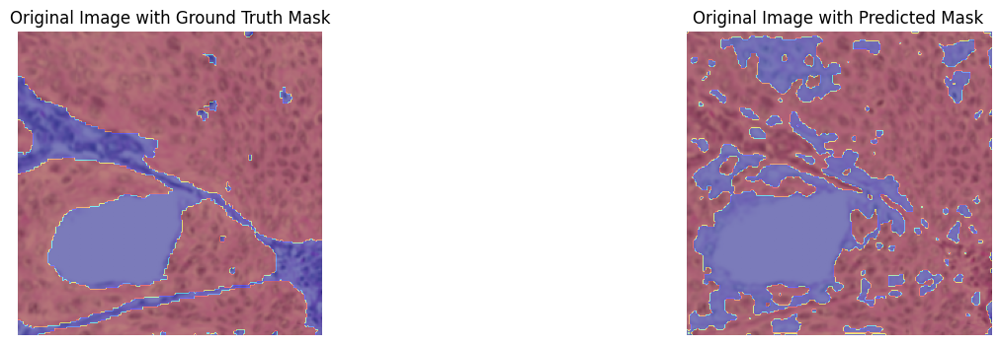

Epoch 2 Loss: 0.6016, Accuracy: 68.22%
Epoch 2 Validation Loss: 0.6127, Validation Accuracy: 67.31%


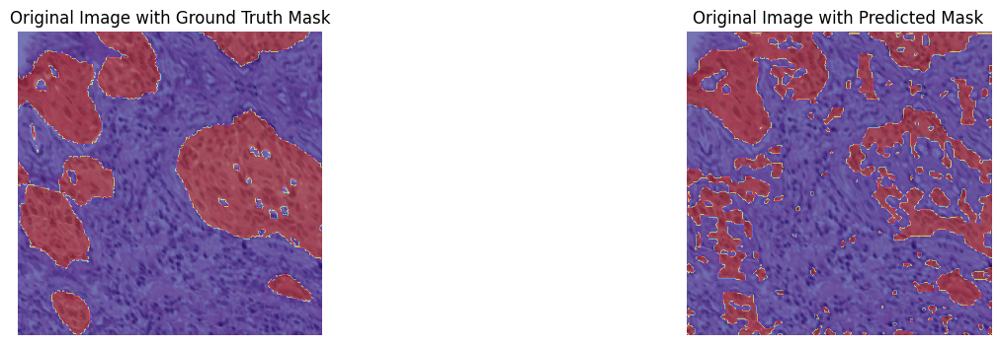

Epoch 3 Loss: 0.6098, Accuracy: 67.34%
Epoch 3 Validation Loss: 0.6032, Validation Accuracy: 66.46%


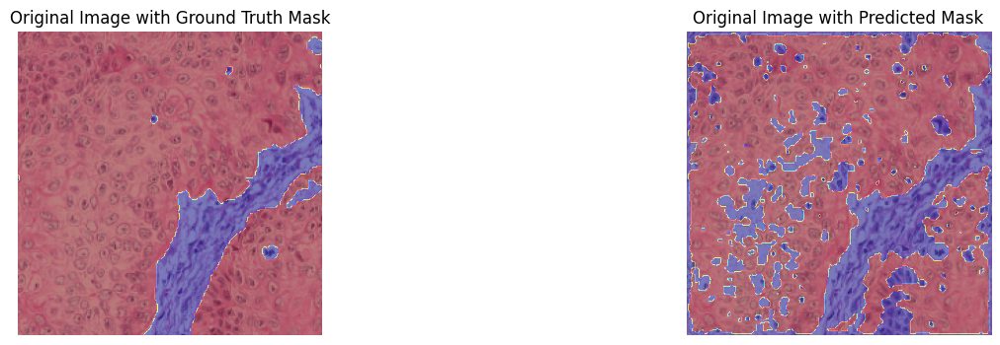

Epoch 4 Loss: 0.6032, Accuracy: 67.31%
Epoch 4 Validation Loss: 0.5492, Validation Accuracy: 71.49%


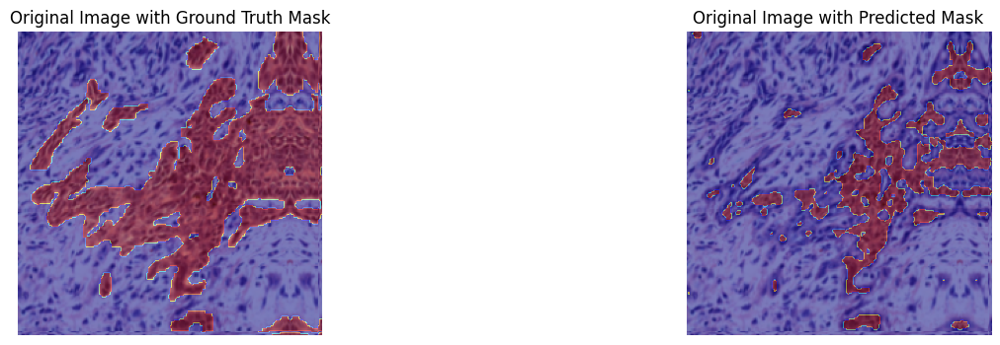

Epoch 5 Loss: 0.5851, Accuracy: 68.70%
Epoch 5 Validation Loss: 0.5710, Validation Accuracy: 70.81%


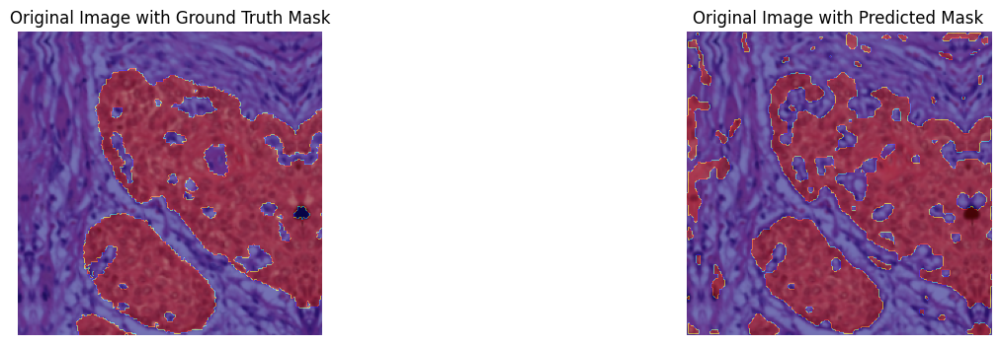

Epoch 6 Loss: 0.5875, Accuracy: 67.86%
Epoch 6 Validation Loss: 0.8882, Validation Accuracy: 61.05%


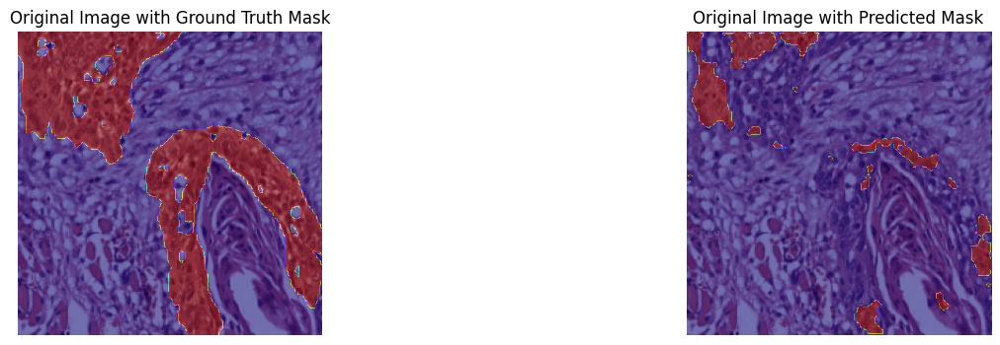

Epoch 7 Loss: 0.5776, Accuracy: 69.60%
Epoch 7 Validation Loss: 0.6075, Validation Accuracy: 66.51%


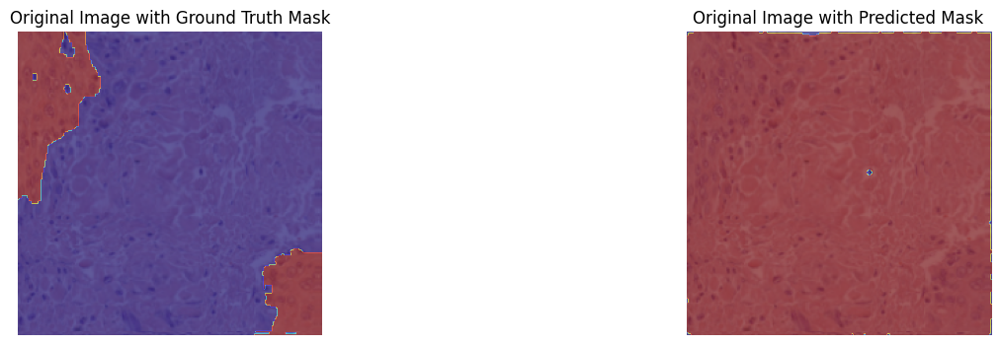

Epoch 8 Loss: 0.5618, Accuracy: 71.20%
Epoch 8 Validation Loss: 0.5765, Validation Accuracy: 69.81%


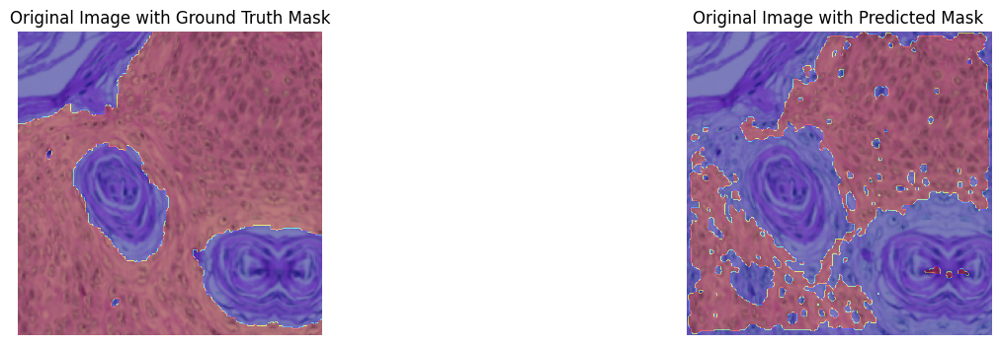

Epoch 9 Loss: 0.5722, Accuracy: 69.91%
Epoch 9 Validation Loss: 0.5637, Validation Accuracy: 71.71%


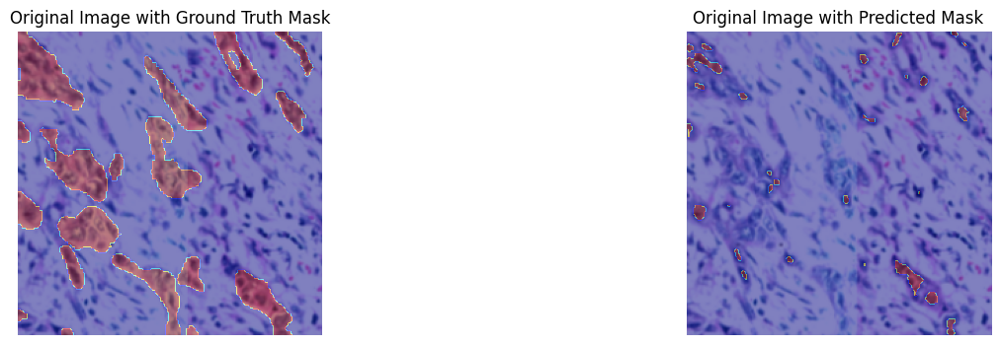

Epoch 10 Loss: 0.5597, Accuracy: 70.92%
Epoch 10 Validation Loss: 0.6067, Validation Accuracy: 66.31%


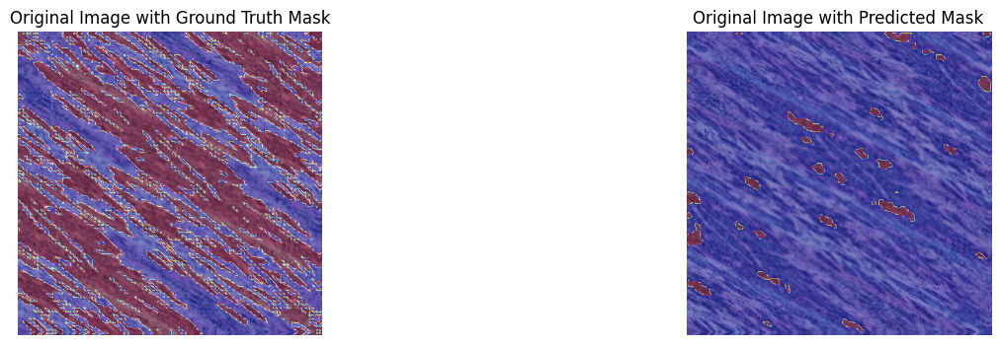

Epoch 11 Loss: 0.5508, Accuracy: 71.58%
Epoch 11 Validation Loss: 0.7753, Validation Accuracy: 51.92%


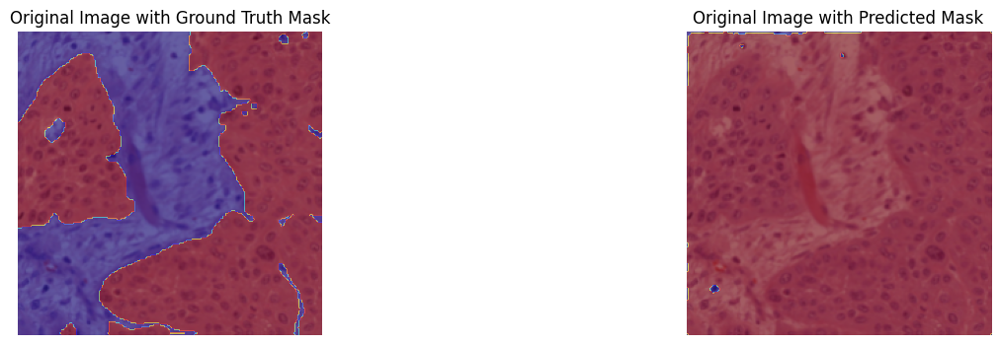

Epoch 12 Loss: 0.5699, Accuracy: 69.32%
Epoch 12 Validation Loss: 0.5836, Validation Accuracy: 68.31%


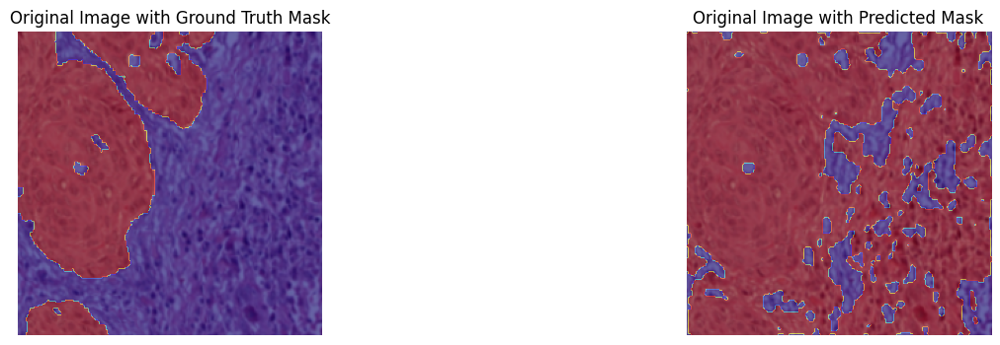

Epoch 13 Loss: 0.5648, Accuracy: 69.98%
Epoch 13 Validation Loss: 0.6274, Validation Accuracy: 62.64%


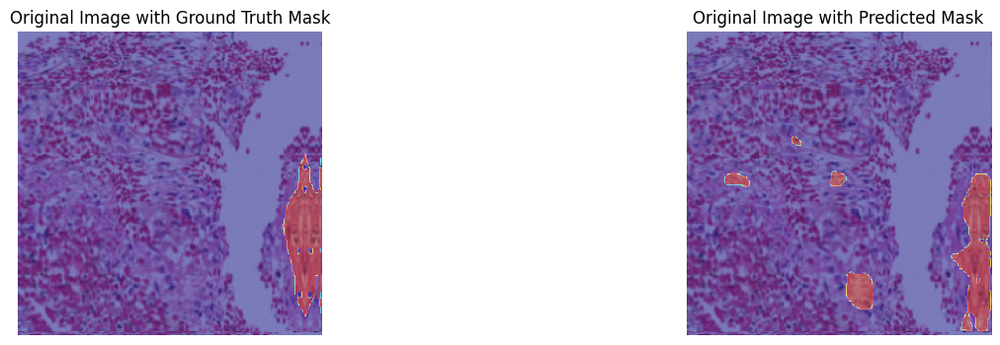

Epoch 14 Loss: 0.5440, Accuracy: 71.54%
Epoch 14 Validation Loss: 0.5204, Validation Accuracy: 73.86%


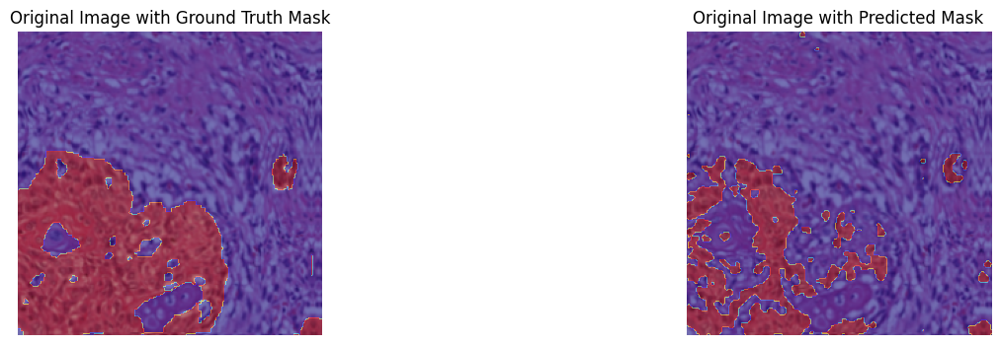

Epoch 15 Loss: 0.5463, Accuracy: 72.08%
Epoch 15 Validation Loss: 0.5128, Validation Accuracy: 74.57%


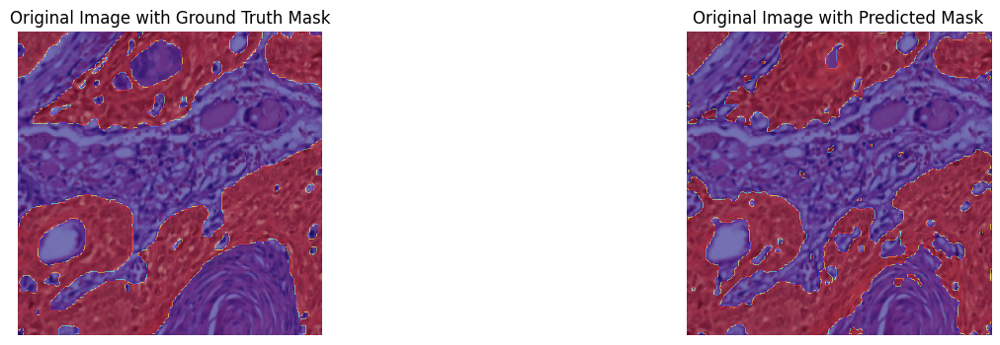

Epoch 16 Loss: 0.5348, Accuracy: 72.01%
Epoch 16 Validation Loss: 0.5667, Validation Accuracy: 69.86%


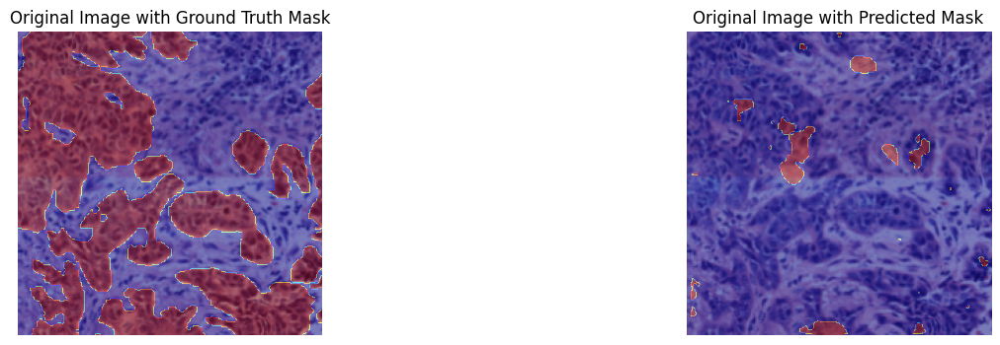

Epoch 17 Loss: 0.5268, Accuracy: 73.12%
Epoch 17 Validation Loss: 0.5922, Validation Accuracy: 64.55%


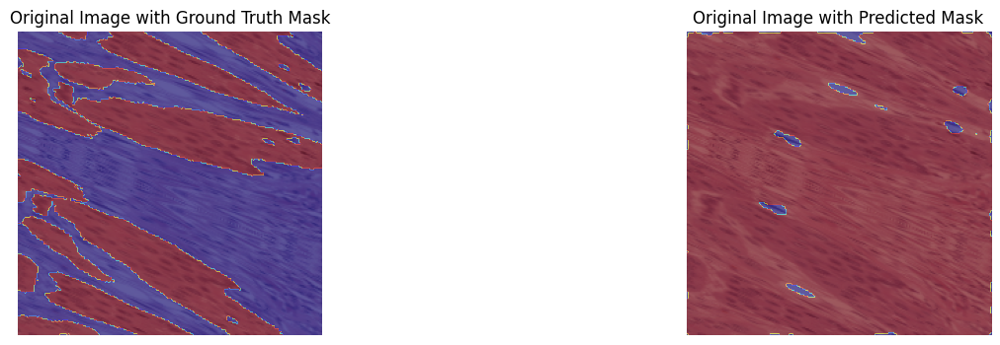

Epoch 18 Loss: 0.5608, Accuracy: 70.51%
Epoch 18 Validation Loss: 0.5417, Validation Accuracy: 71.63%


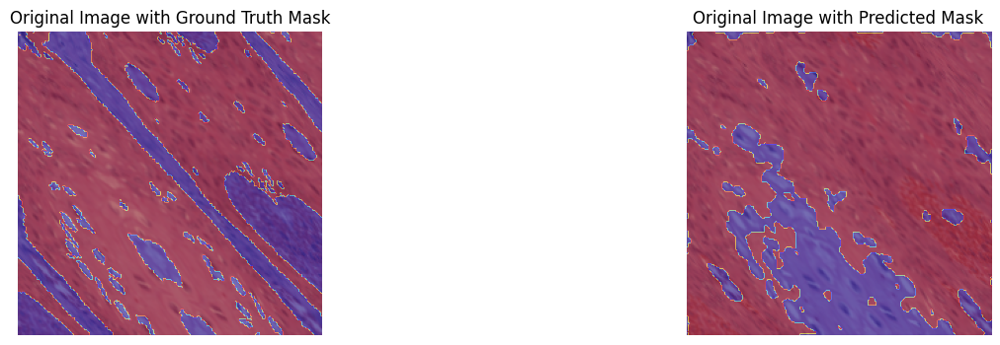

Epoch 19 Loss: 0.5393, Accuracy: 72.03%
Epoch 19 Validation Loss: 0.5669, Validation Accuracy: 67.12%


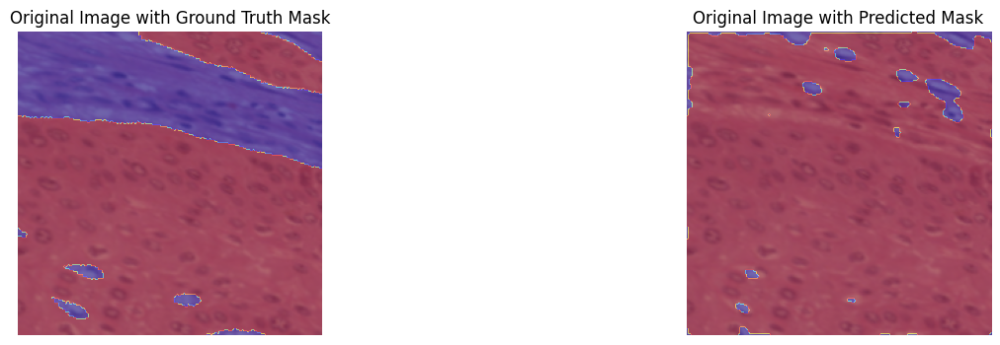

Epoch 20 Loss: 0.5393, Accuracy: 72.18%
Epoch 20 Validation Loss: 0.5780, Validation Accuracy: 72.88%


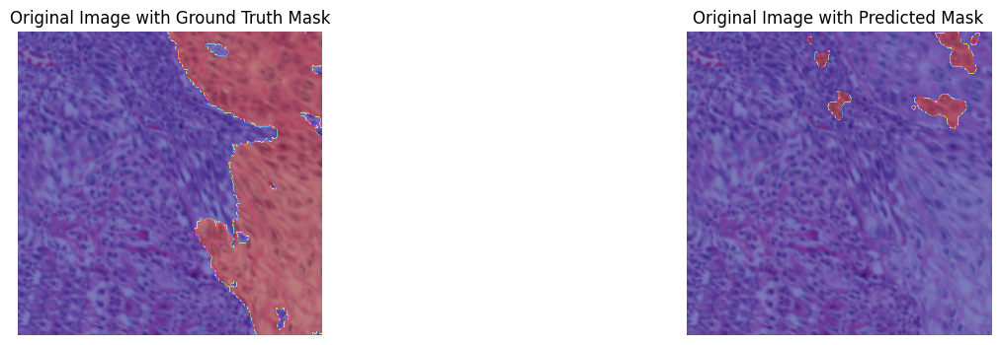

Epoch 21 Loss: 0.5383, Accuracy: 71.16%
Epoch 21 Validation Loss: 0.6334, Validation Accuracy: 70.36%


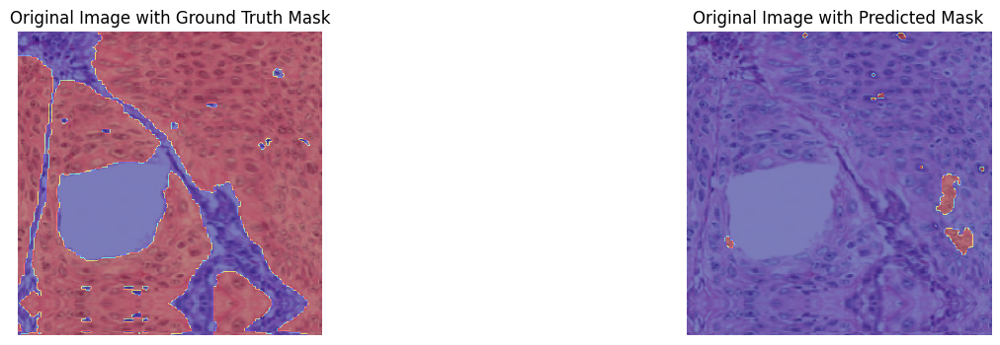

Epoch 22 Loss: 0.5224, Accuracy: 73.32%
Epoch 22 Validation Loss: 0.6113, Validation Accuracy: 61.61%


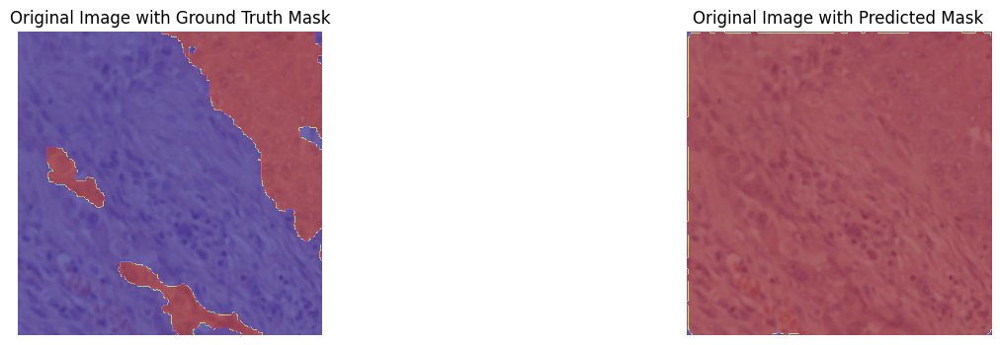

Epoch 23 Loss: 0.5133, Accuracy: 73.49%
Epoch 23 Validation Loss: 0.4972, Validation Accuracy: 76.22%


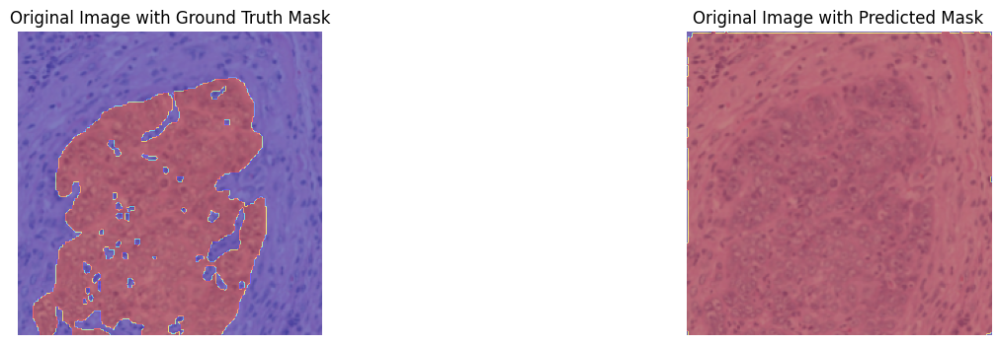

Epoch 24 Loss: 0.5198, Accuracy: 73.01%
Epoch 24 Validation Loss: 0.5252, Validation Accuracy: 69.79%


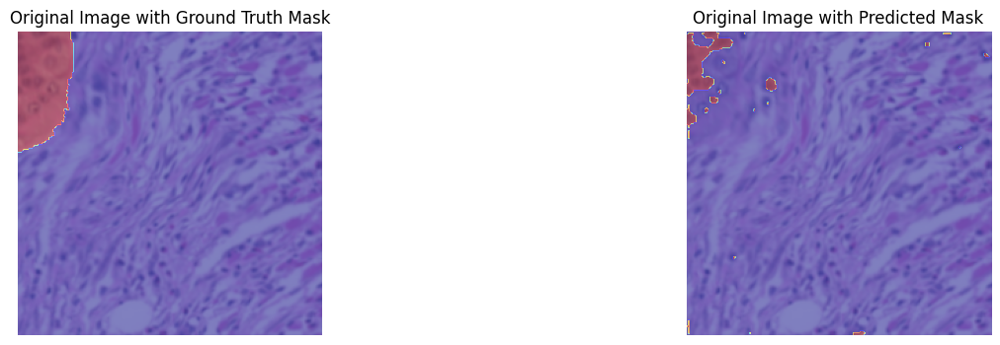

Epoch 25 Loss: 0.5152, Accuracy: 74.56%
Epoch 25 Validation Loss: 0.6151, Validation Accuracy: 66.16%


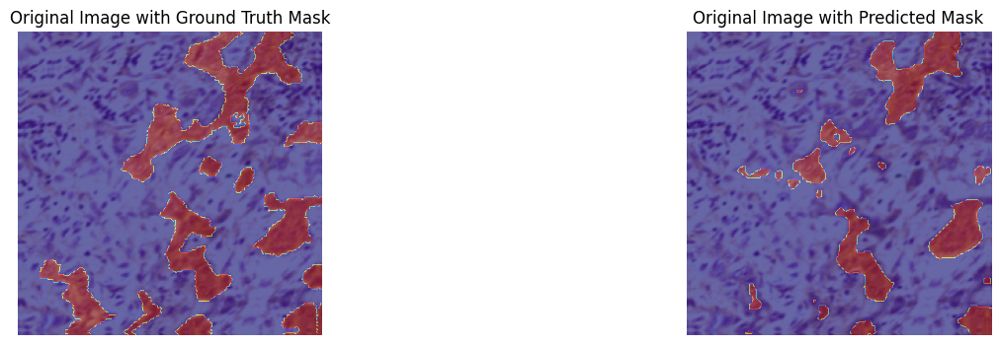

Epoch 26 Loss: 0.5212, Accuracy: 74.22%
Epoch 26 Validation Loss: 0.5885, Validation Accuracy: 69.04%


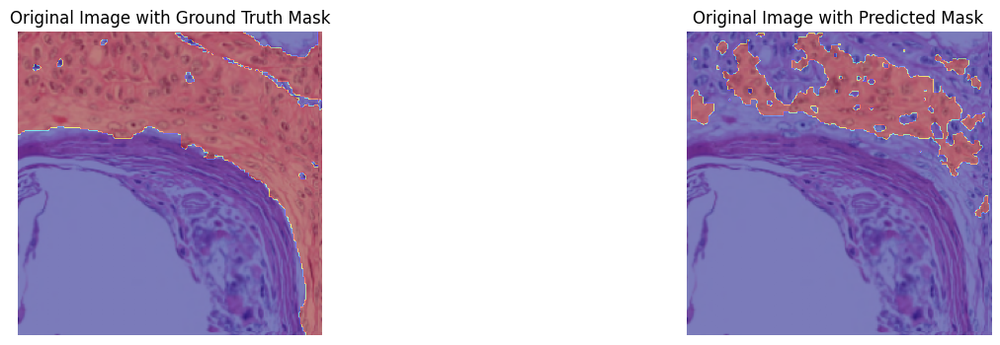

Epoch 27 Loss: 0.4993, Accuracy: 75.10%
Epoch 27 Validation Loss: 0.4811, Validation Accuracy: 77.11%


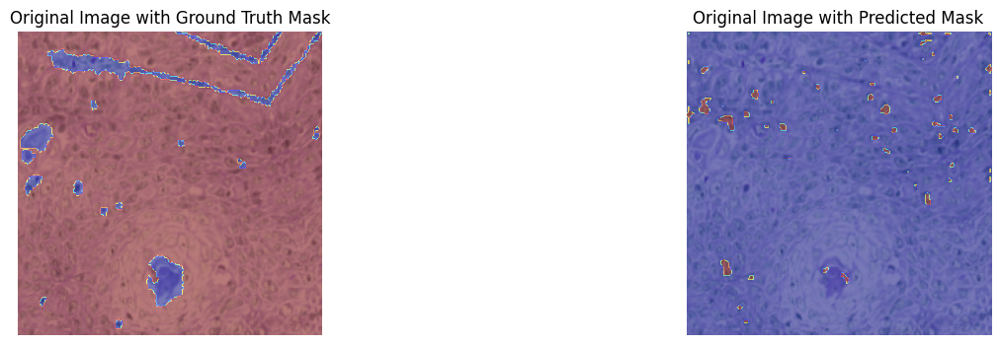

Epoch 28 Loss: 0.5059, Accuracy: 74.75%
Epoch 28 Validation Loss: 0.5498, Validation Accuracy: 72.08%


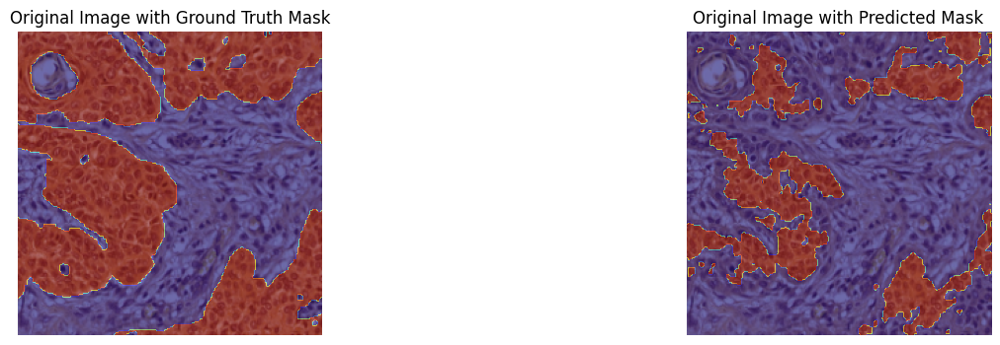

Epoch 29 Loss: 0.5107, Accuracy: 73.68%
Epoch 29 Validation Loss: 0.5991, Validation Accuracy: 70.75%


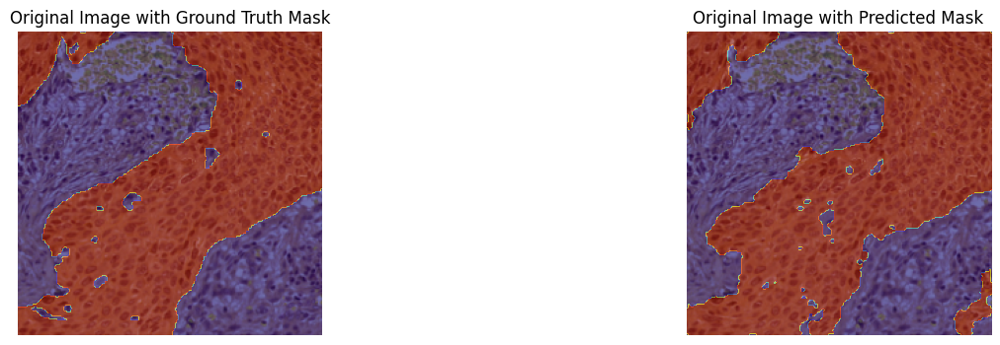

Epoch 30 Loss: 0.5253, Accuracy: 73.89%
Epoch 30 Validation Loss: 0.5939, Validation Accuracy: 64.17%


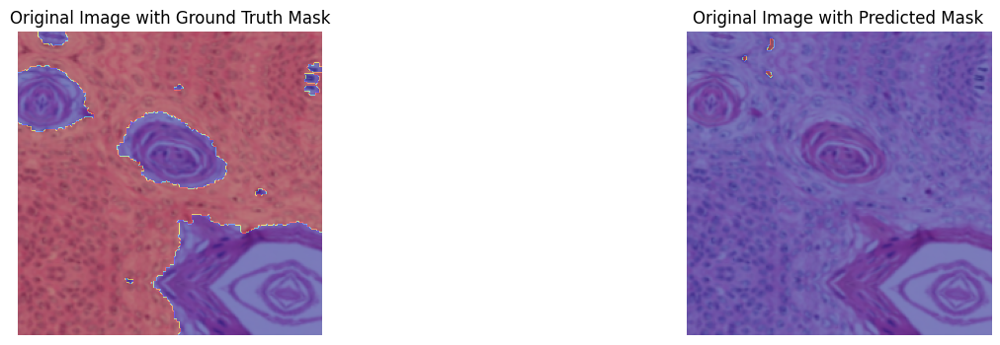

Epoch 31 Loss: 0.5275, Accuracy: 72.63%
Epoch 31 Validation Loss: 0.7071, Validation Accuracy: 62.57%


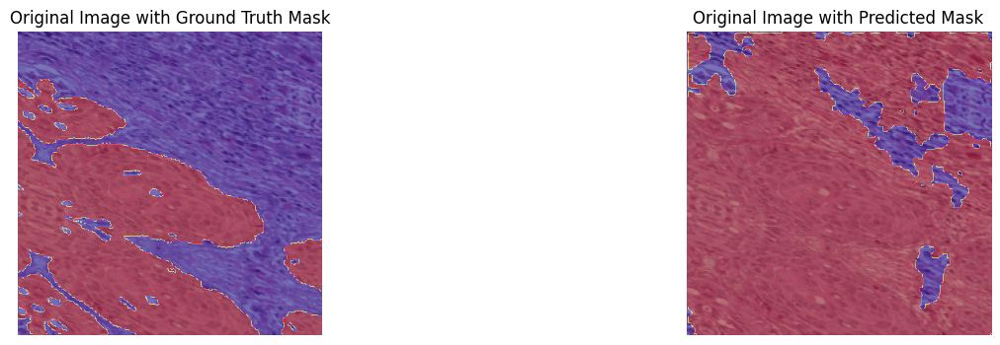

Epoch 32 Loss: 0.5146, Accuracy: 73.65%
Epoch 32 Validation Loss: 0.4620, Validation Accuracy: 79.45%


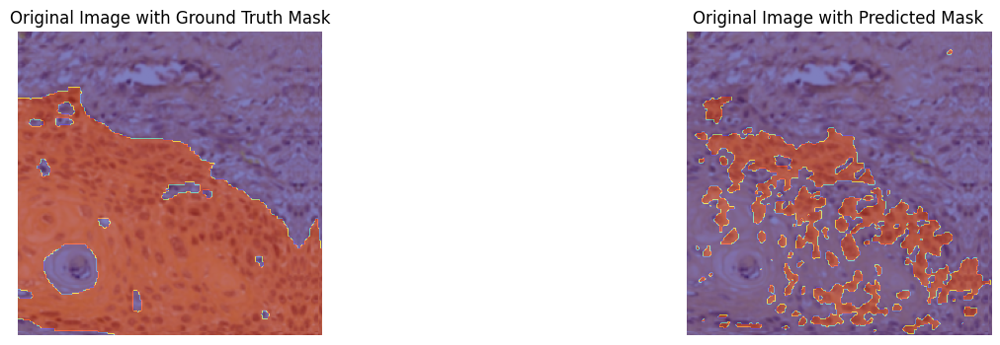

Epoch 33 Loss: 0.5081, Accuracy: 75.01%
Epoch 33 Validation Loss: 0.4770, Validation Accuracy: 77.38%


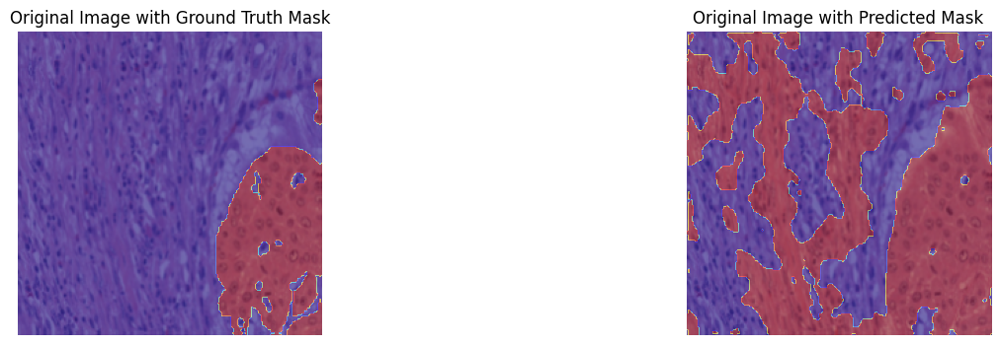

Epoch 34 Loss: 0.5024, Accuracy: 75.05%
Epoch 34 Validation Loss: 0.5631, Validation Accuracy: 71.18%


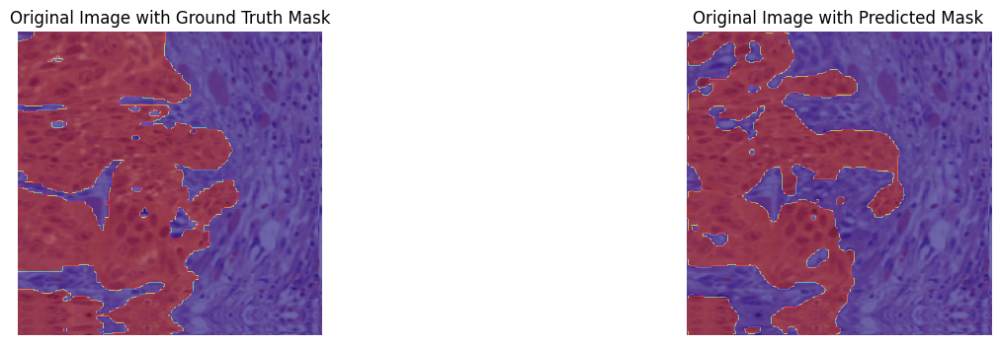

Epoch 35 Loss: 0.4981, Accuracy: 75.55%
Epoch 35 Validation Loss: 0.5545, Validation Accuracy: 71.12%


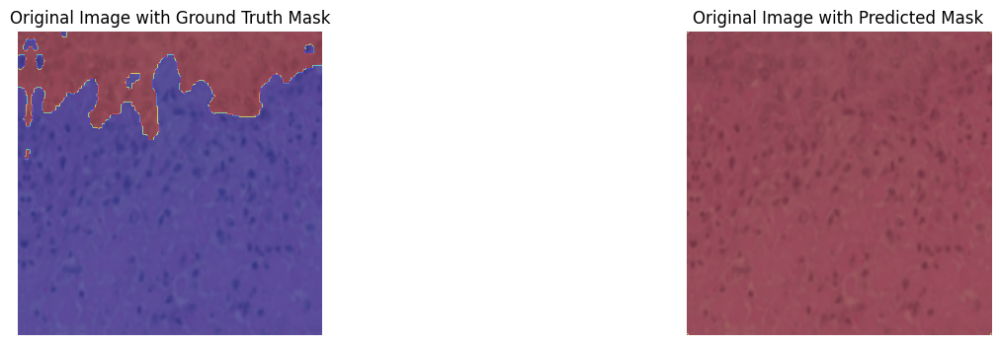

Epoch 36 Loss: 0.4935, Accuracy: 76.00%
Epoch 36 Validation Loss: 0.5265, Validation Accuracy: 75.09%


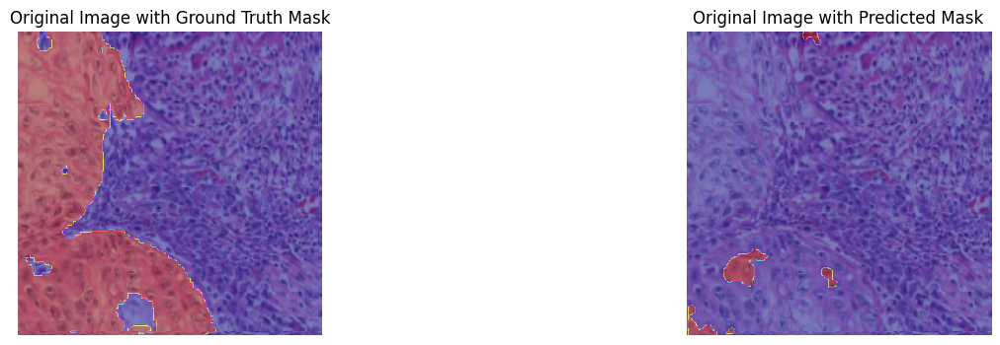

Epoch 37 Loss: 0.5048, Accuracy: 74.15%
Epoch 37 Validation Loss: 0.5252, Validation Accuracy: 74.66%


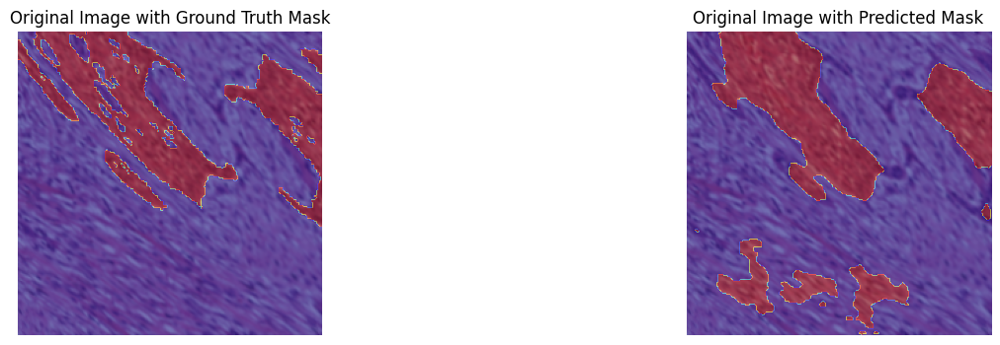

Epoch 38 Loss: 0.4822, Accuracy: 76.52%
Epoch 38 Validation Loss: 0.5509, Validation Accuracy: 72.67%


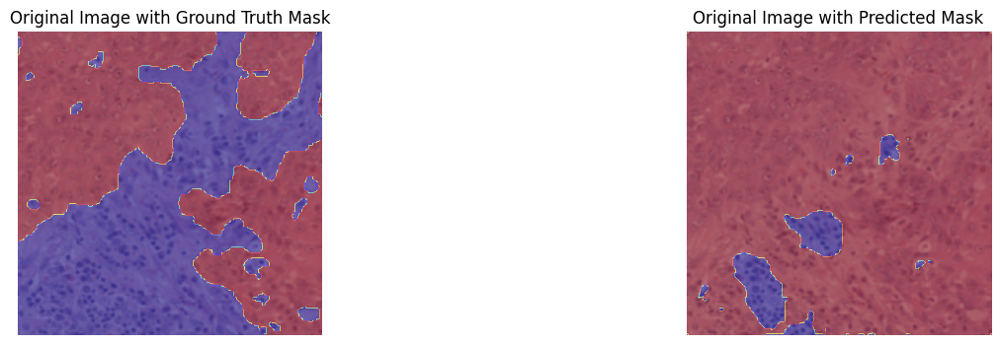

Epoch 39 Loss: 0.5020, Accuracy: 74.82%
Epoch 39 Validation Loss: 0.5247, Validation Accuracy: 70.33%


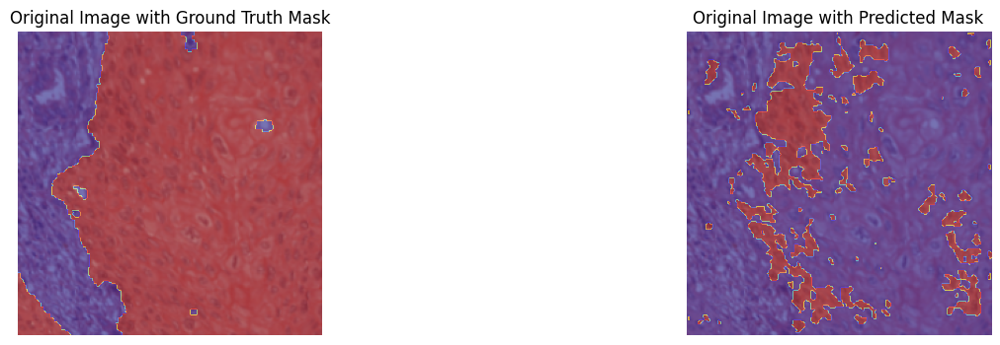

Epoch 40 Loss: 0.4951, Accuracy: 75.76%
Epoch 40 Validation Loss: 0.6281, Validation Accuracy: 67.67%


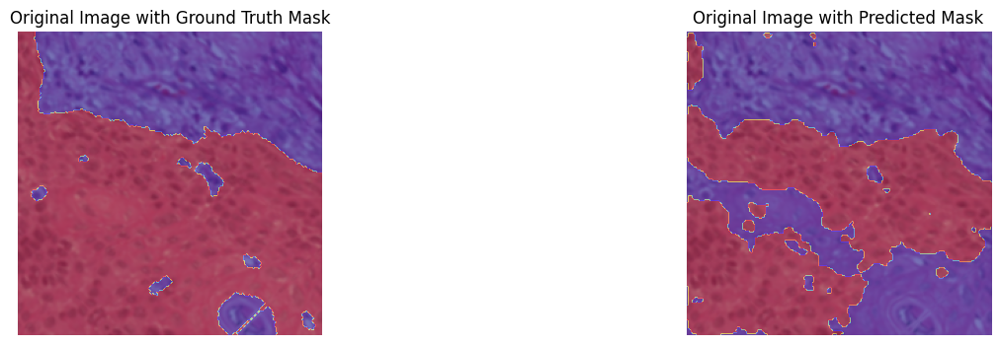

Epoch 41 Loss: 0.4982, Accuracy: 75.95%
Epoch 41 Validation Loss: 0.6259, Validation Accuracy: 70.19%


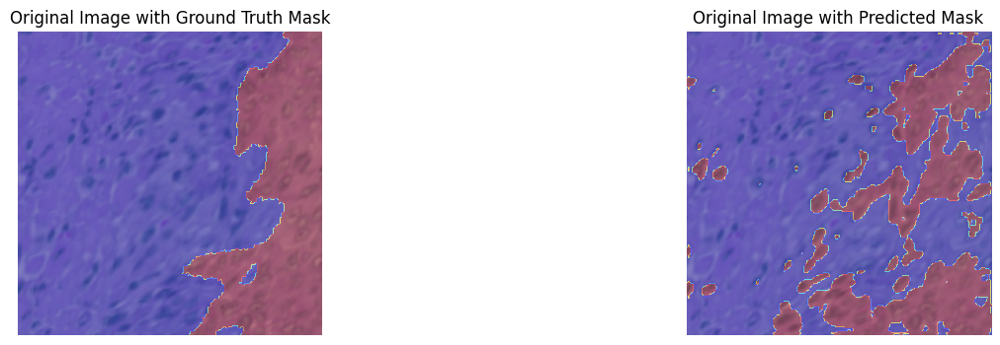

Epoch 42 Loss: 0.4739, Accuracy: 77.30%
Epoch 42 Validation Loss: 0.4721, Validation Accuracy: 76.80%


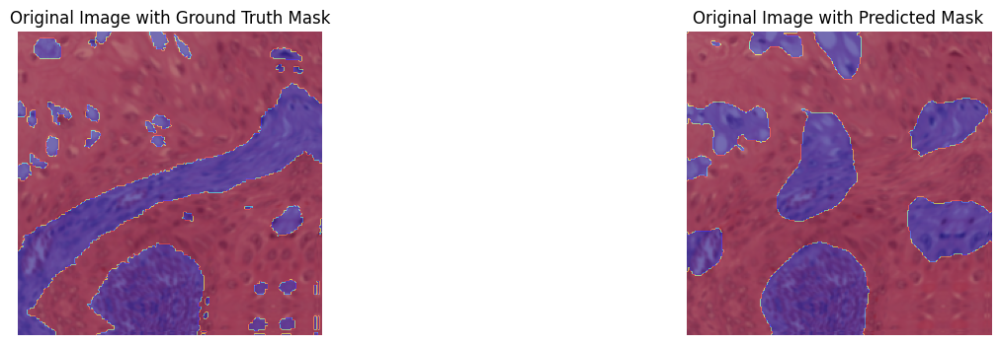

Epoch 43 Loss: 0.4684, Accuracy: 77.84%
Epoch 43 Validation Loss: 0.6978, Validation Accuracy: 63.69%


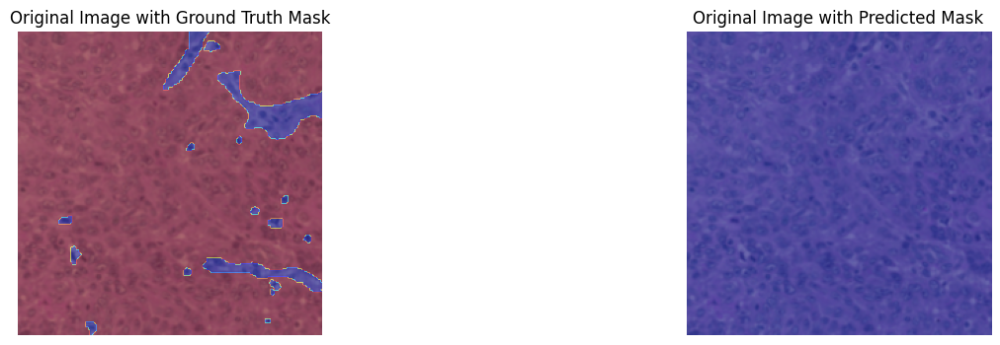

Epoch 44 Loss: 0.4799, Accuracy: 77.02%
Epoch 44 Validation Loss: 0.6045, Validation Accuracy: 70.57%


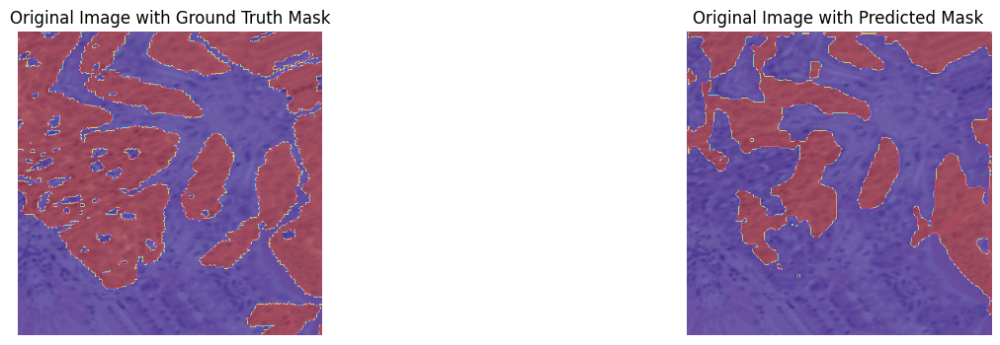

Epoch 45 Loss: 0.4537, Accuracy: 78.41%
Epoch 45 Validation Loss: 0.4876, Validation Accuracy: 76.85%


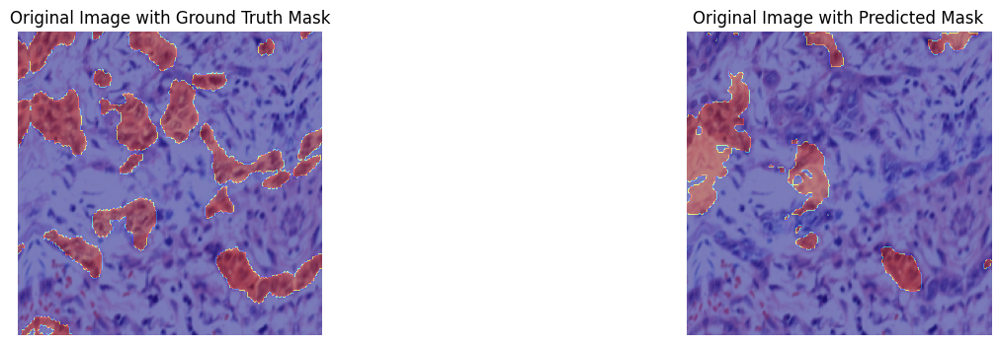

Epoch 46 Loss: 0.4827, Accuracy: 77.36%
Epoch 46 Validation Loss: 0.7652, Validation Accuracy: 63.41%


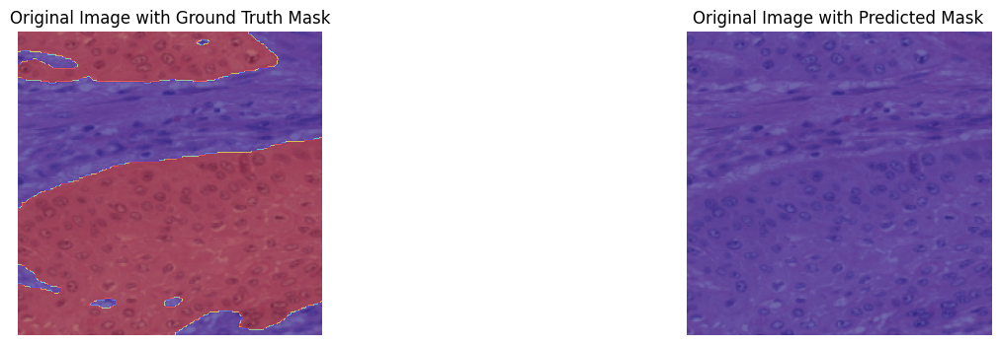

Epoch 47 Loss: 0.4754, Accuracy: 77.09%
Epoch 47 Validation Loss: 0.4704, Validation Accuracy: 76.99%


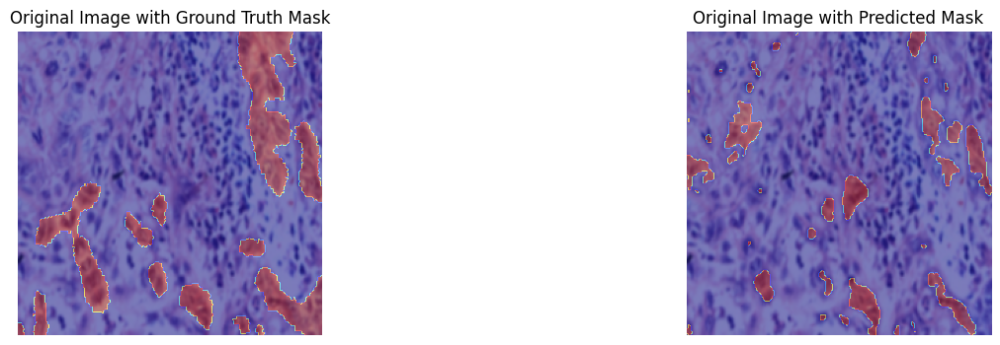

Epoch 48 Loss: 0.4663, Accuracy: 77.29%
Epoch 48 Validation Loss: 0.6370, Validation Accuracy: 68.54%


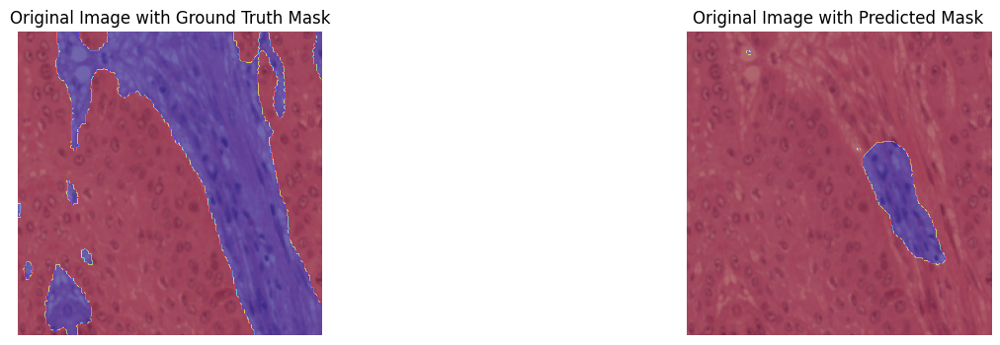

Epoch 49 Loss: 0.4778, Accuracy: 77.34%
Epoch 49 Validation Loss: 0.5068, Validation Accuracy: 75.30%


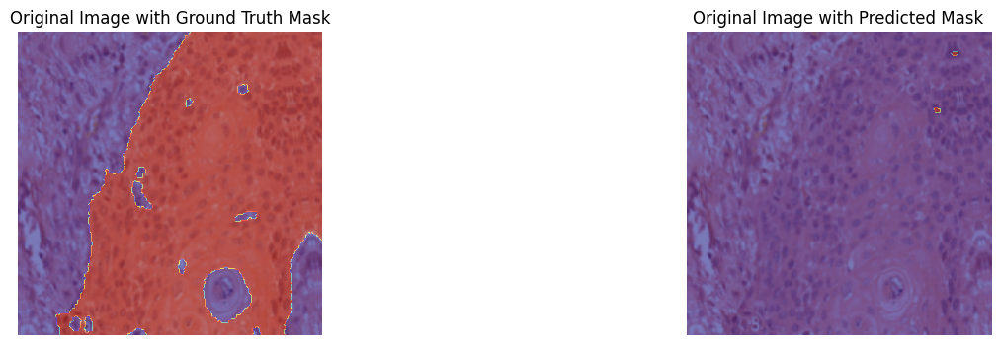

Epoch 50 Loss: 0.4566, Accuracy: 78.17%
Epoch 50 Validation Loss: 0.5590, Validation Accuracy: 70.59%


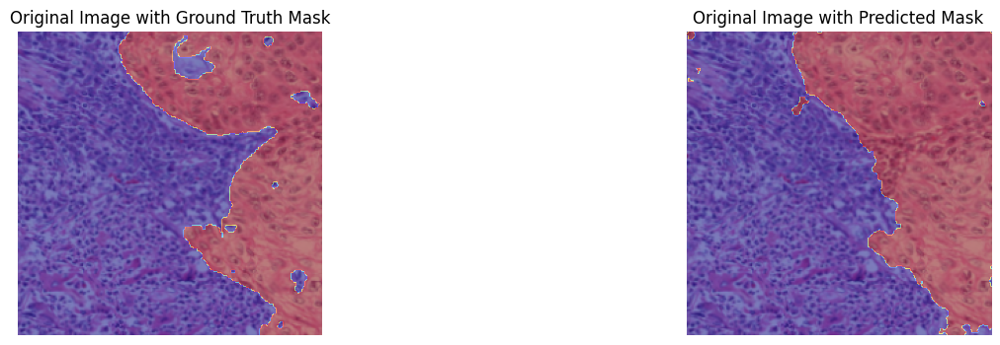

Epoch 51 Loss: 0.4600, Accuracy: 78.43%
Epoch 51 Validation Loss: 0.6786, Validation Accuracy: 65.71%


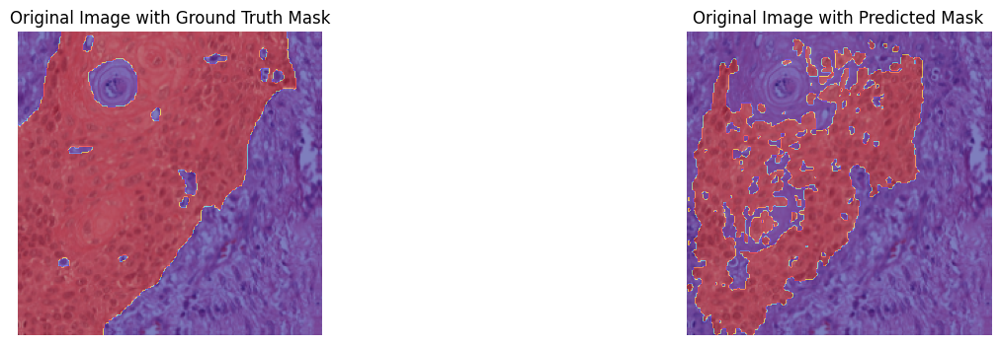

Epoch 52 Loss: 0.4576, Accuracy: 78.38%
Epoch 52 Validation Loss: 1.0324, Validation Accuracy: 58.60%


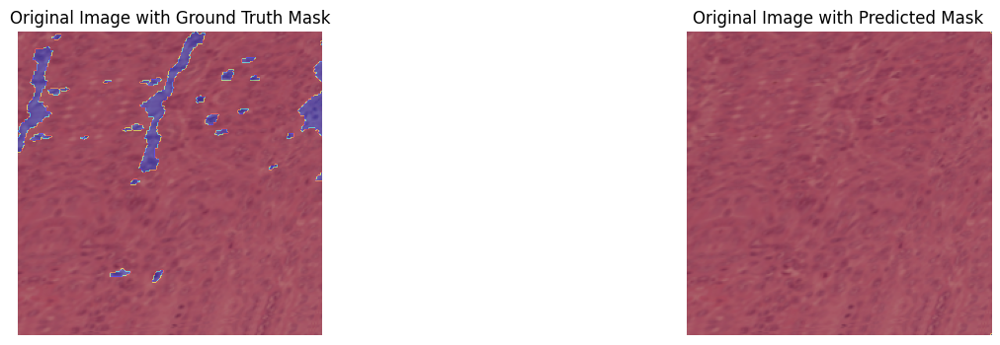

Epoch 53 Loss: 0.4445, Accuracy: 78.73%
Epoch 53 Validation Loss: 0.7324, Validation Accuracy: 63.65%


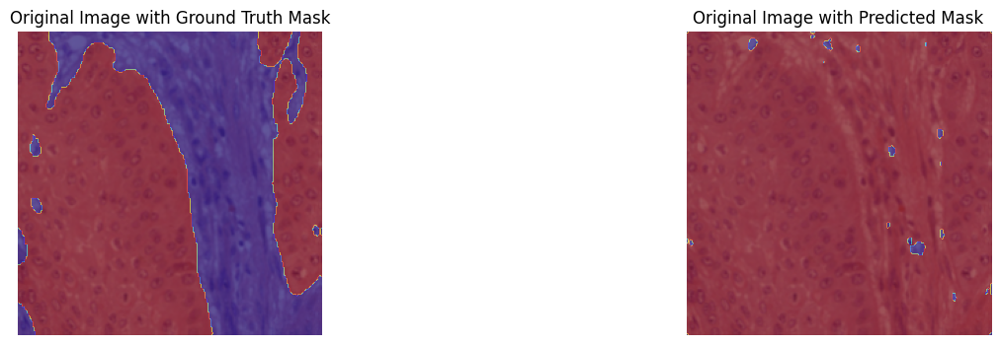

Epoch 54 Loss: 0.4539, Accuracy: 78.44%
Epoch 54 Validation Loss: 0.4976, Validation Accuracy: 75.45%


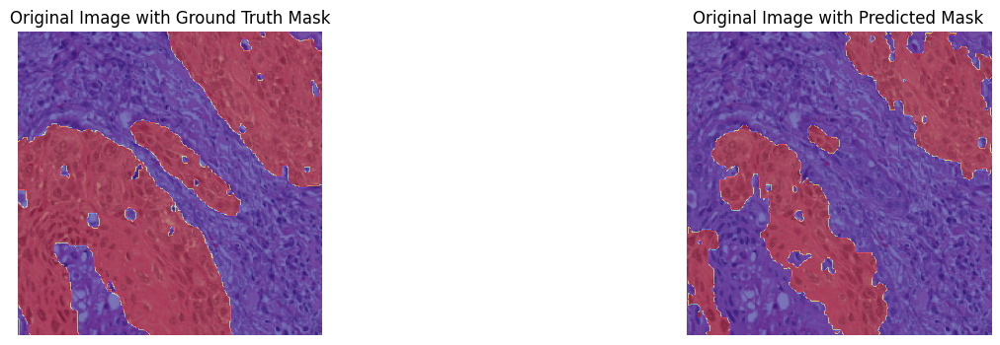

Epoch 55 Loss: 0.4798, Accuracy: 77.54%
Epoch 55 Validation Loss: 0.5669, Validation Accuracy: 68.84%


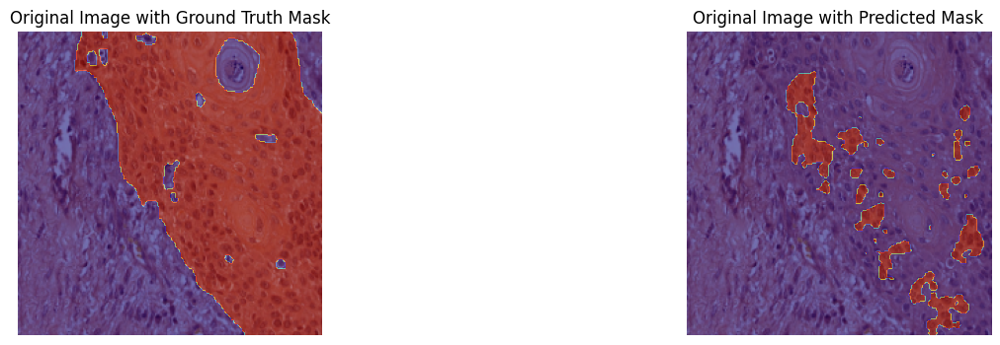

Epoch 56 Loss: 0.4475, Accuracy: 78.97%
Epoch 56 Validation Loss: 0.7633, Validation Accuracy: 64.69%


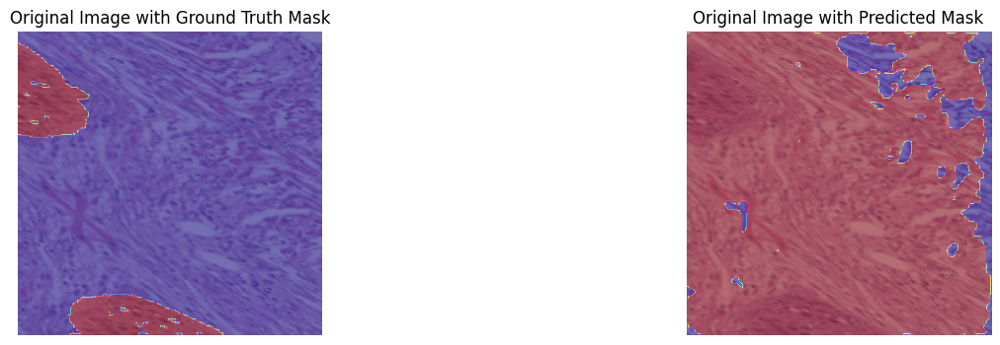

Epoch 57 Loss: 0.4354, Accuracy: 79.07%
Epoch 57 Validation Loss: 0.4723, Validation Accuracy: 77.41%


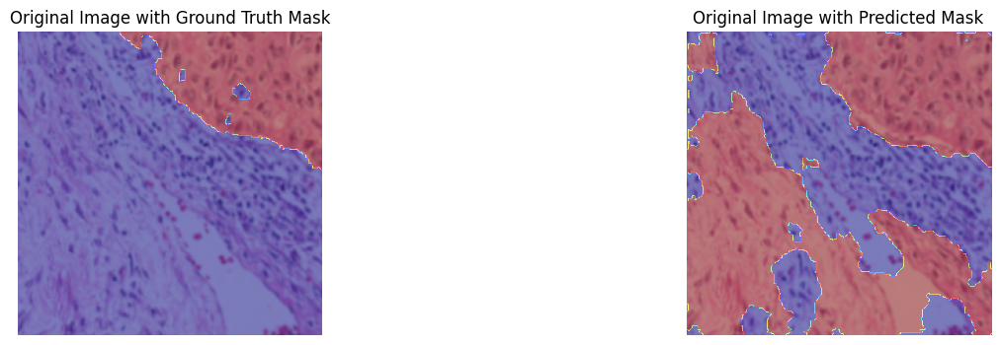

Epoch 58 Loss: 0.4283, Accuracy: 79.99%
Epoch 58 Validation Loss: 0.4853, Validation Accuracy: 75.98%


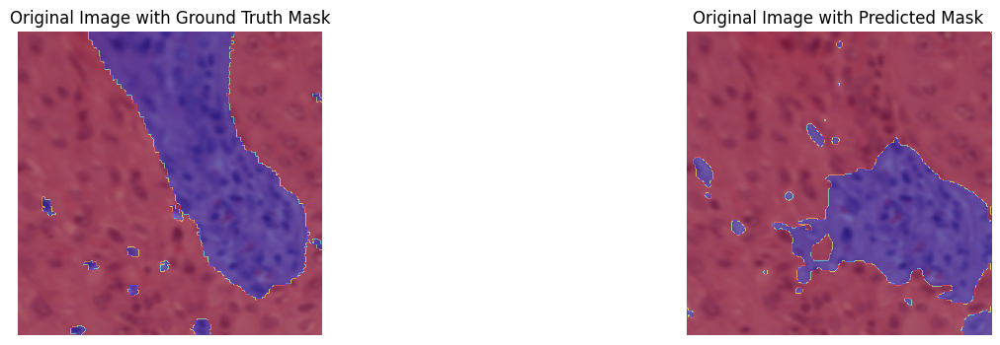

Epoch 59 Loss: 0.4222, Accuracy: 80.79%
Epoch 59 Validation Loss: 0.5949, Validation Accuracy: 69.70%


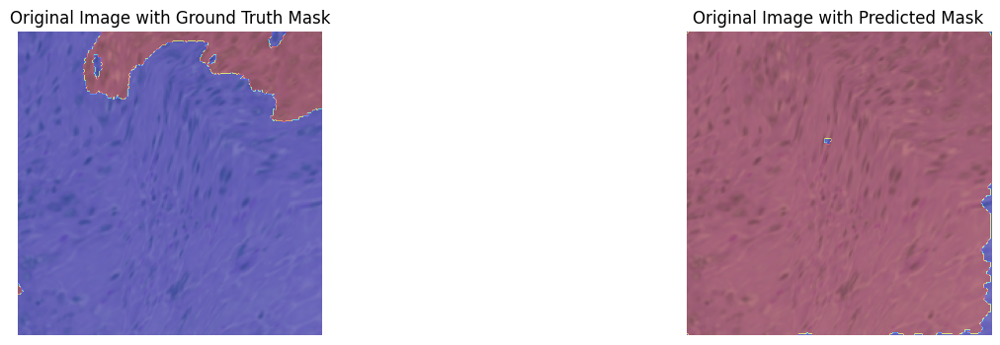

Epoch 60 Loss: 0.4705, Accuracy: 77.11%
Epoch 60 Validation Loss: 0.9327, Validation Accuracy: 58.15%


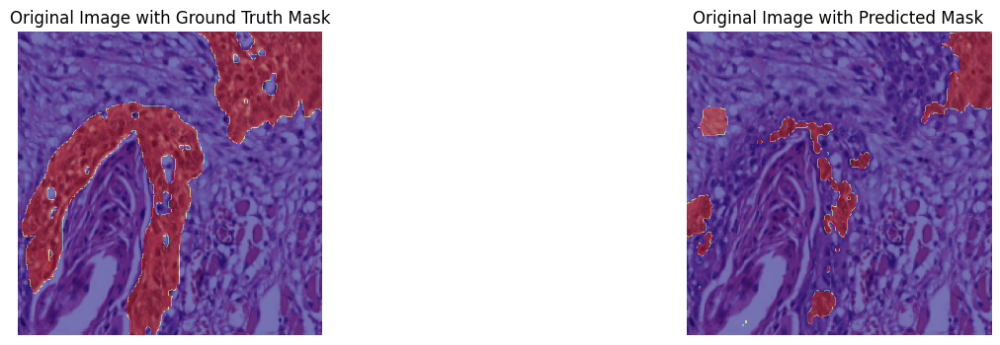

Epoch 61 Loss: 0.4422, Accuracy: 78.76%
Epoch 61 Validation Loss: 0.7120, Validation Accuracy: 68.40%


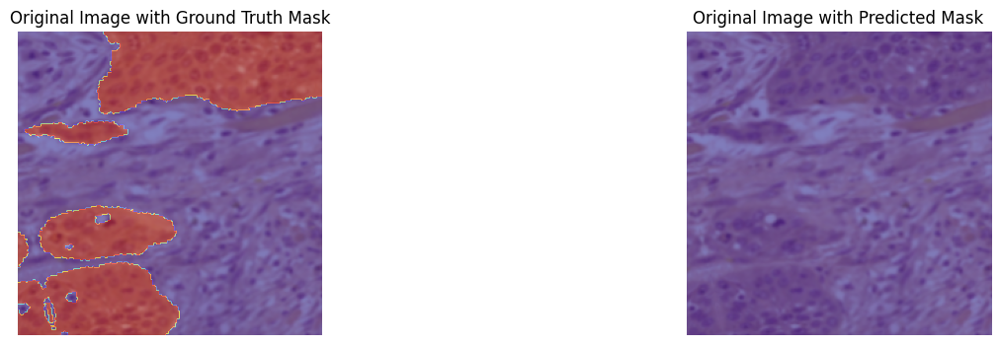

Epoch 62 Loss: 0.4060, Accuracy: 81.39%
Epoch 62 Validation Loss: 0.4605, Validation Accuracy: 78.29%


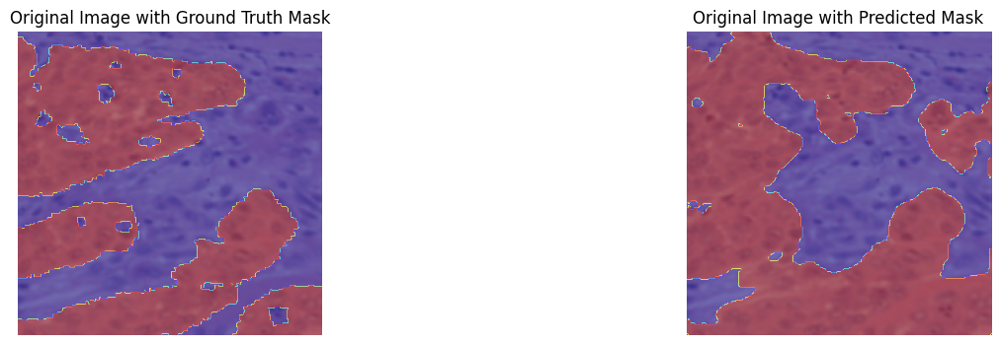

Epoch 63 Loss: 0.4041, Accuracy: 81.73%
Epoch 63 Validation Loss: 0.4486, Validation Accuracy: 78.46%


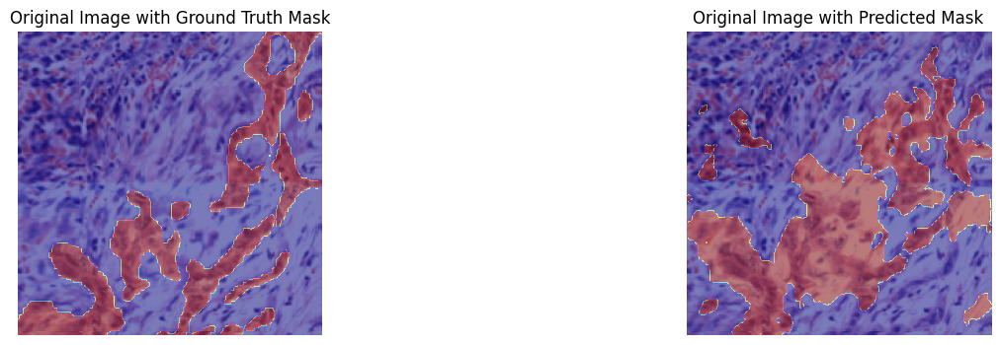

Epoch 64 Loss: 0.4091, Accuracy: 81.69%
Epoch 64 Validation Loss: 0.5272, Validation Accuracy: 76.85%


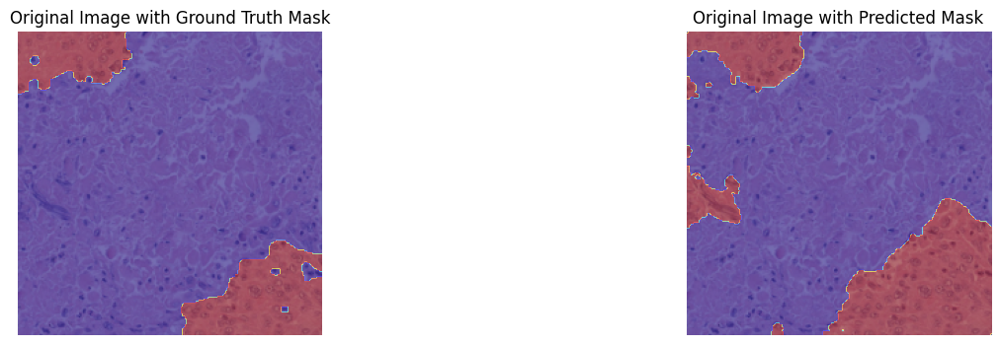

Epoch 65 Loss: 0.4013, Accuracy: 81.64%
Epoch 65 Validation Loss: 0.4551, Validation Accuracy: 78.30%


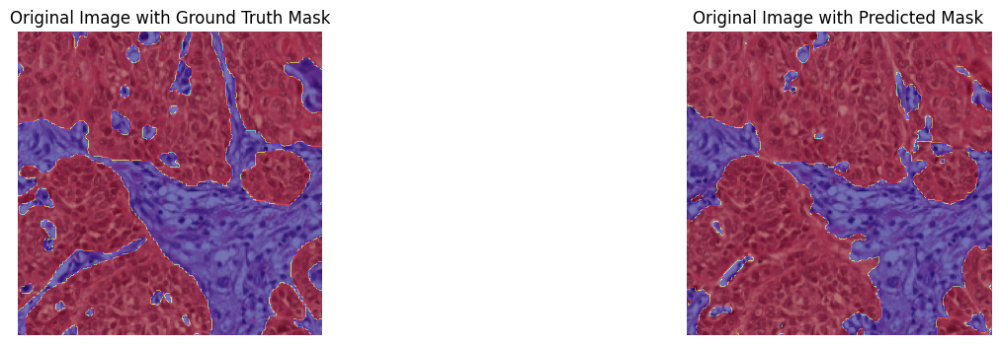

Epoch 66 Loss: 0.4081, Accuracy: 81.28%
Epoch 66 Validation Loss: 0.6422, Validation Accuracy: 70.54%


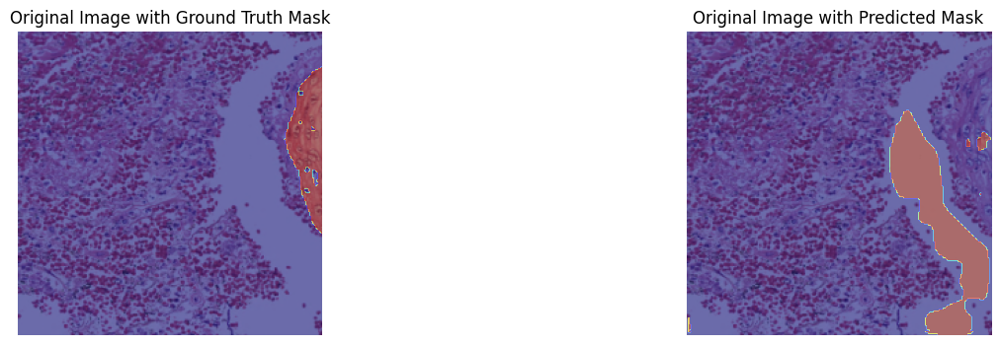

Epoch 67 Loss: 0.4061, Accuracy: 81.28%
Epoch 67 Validation Loss: 0.4800, Validation Accuracy: 76.72%


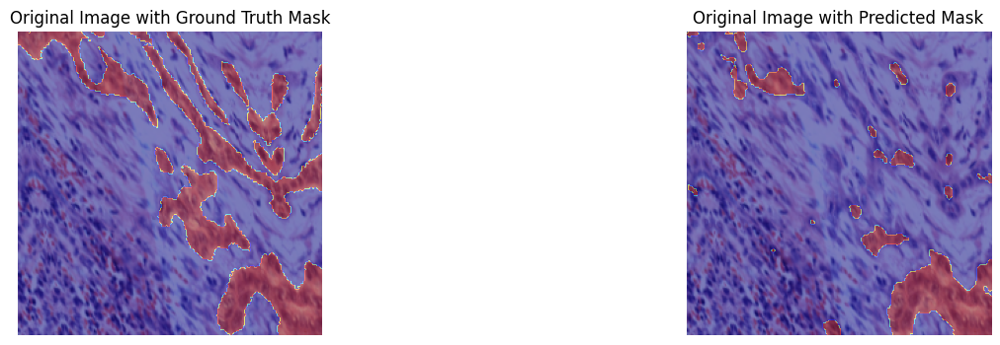

Epoch 68 Loss: 0.4069, Accuracy: 81.33%
Epoch 68 Validation Loss: 0.6595, Validation Accuracy: 66.17%


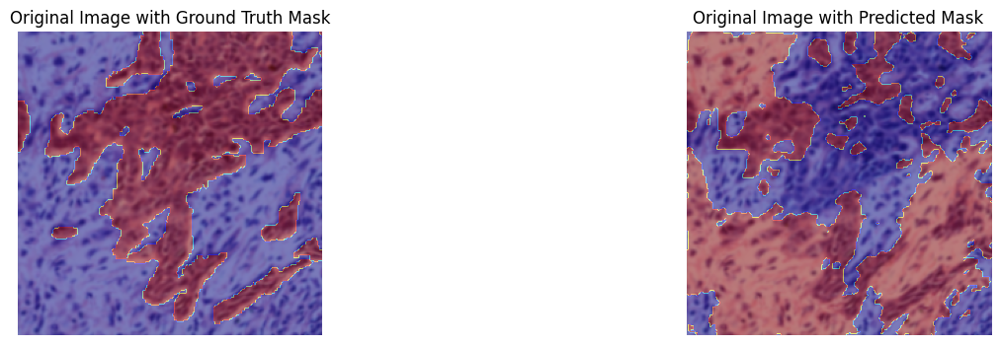

Epoch 69 Loss: 0.3958, Accuracy: 82.02%
Epoch 69 Validation Loss: 0.5233, Validation Accuracy: 74.11%


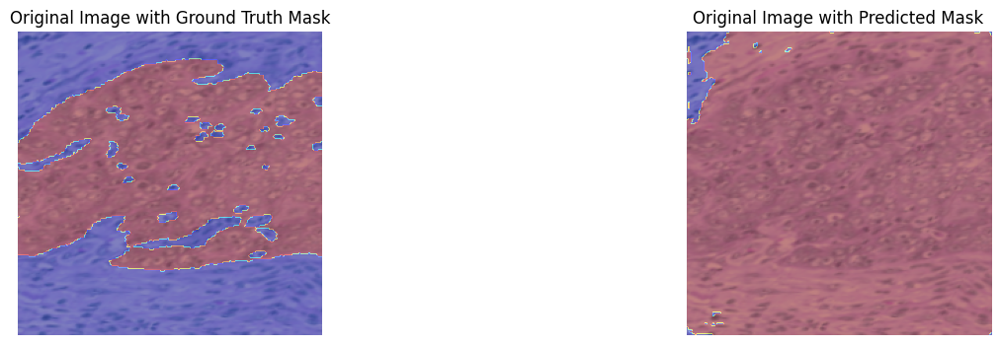

Epoch 70 Loss: 0.3936, Accuracy: 81.90%
Epoch 70 Validation Loss: 1.7334, Validation Accuracy: 59.20%


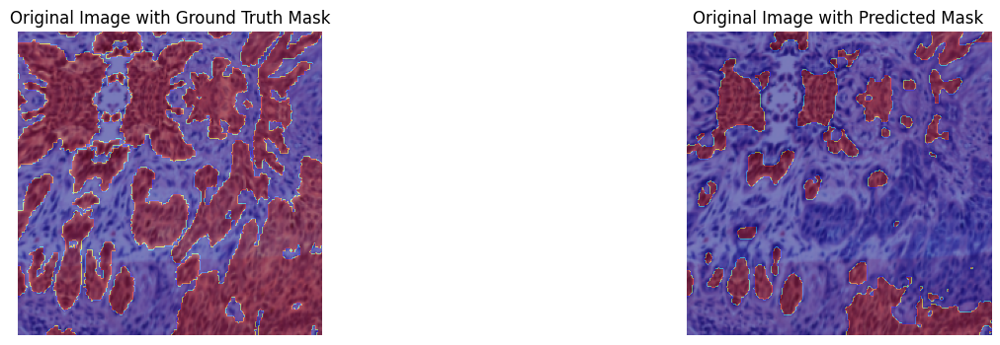

Epoch 71 Loss: 0.3861, Accuracy: 82.57%
Epoch 71 Validation Loss: 0.3771, Validation Accuracy: 83.88%


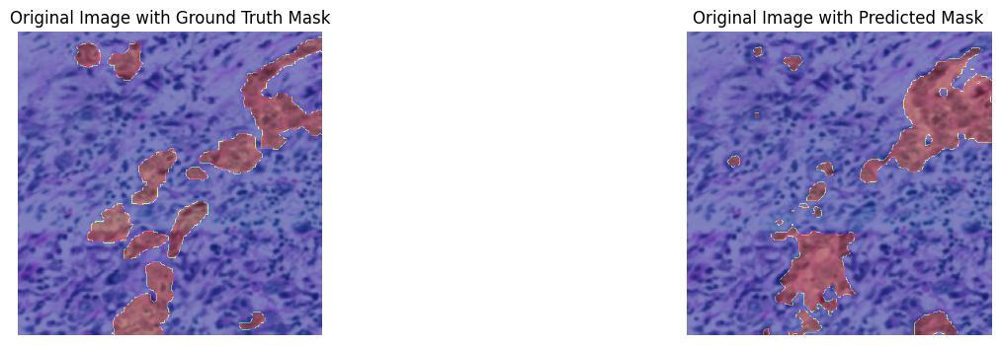

Epoch 72 Loss: 0.3733, Accuracy: 83.09%
Epoch 72 Validation Loss: 0.3891, Validation Accuracy: 83.93%


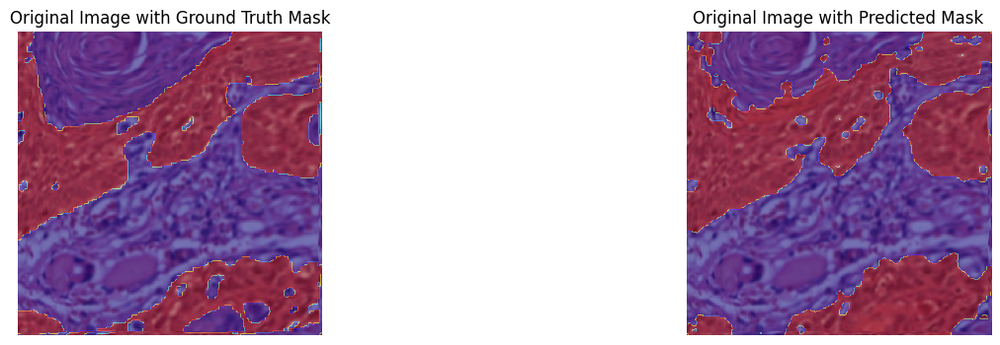

Epoch 73 Loss: 0.3729, Accuracy: 83.71%
Epoch 73 Validation Loss: 0.6572, Validation Accuracy: 78.39%


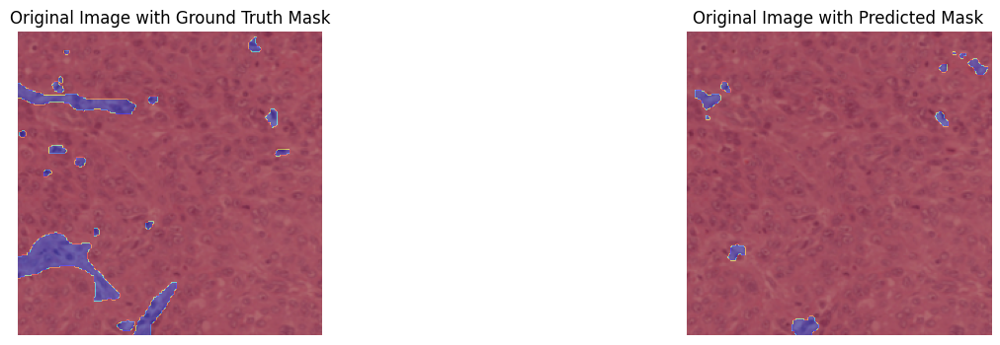

Epoch 74 Loss: 0.3562, Accuracy: 84.21%
Epoch 74 Validation Loss: 0.5632, Validation Accuracy: 71.30%


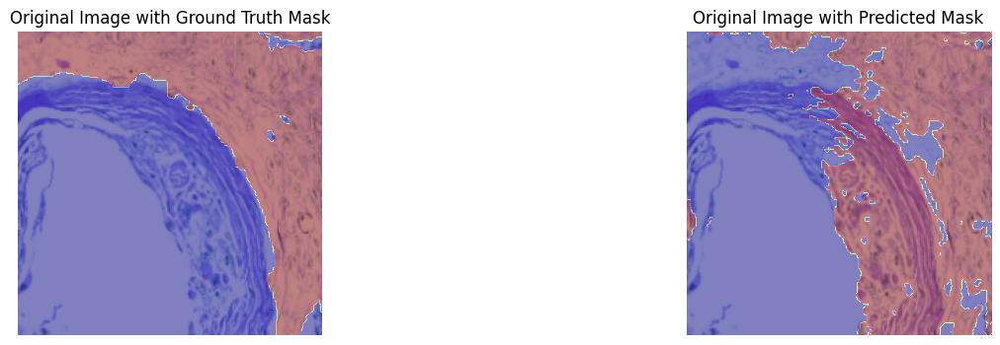

Epoch 75 Loss: 0.3571, Accuracy: 84.17%
Epoch 75 Validation Loss: 0.3851, Validation Accuracy: 83.58%


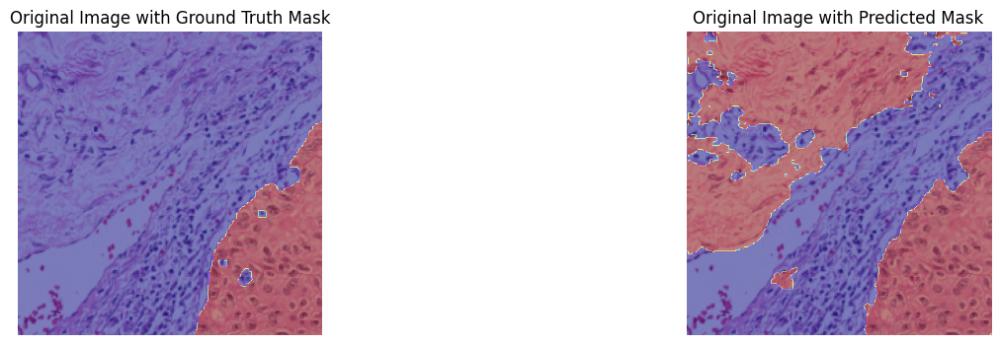

Epoch 76 Loss: 0.3604, Accuracy: 84.00%
Epoch 76 Validation Loss: 0.4497, Validation Accuracy: 79.19%


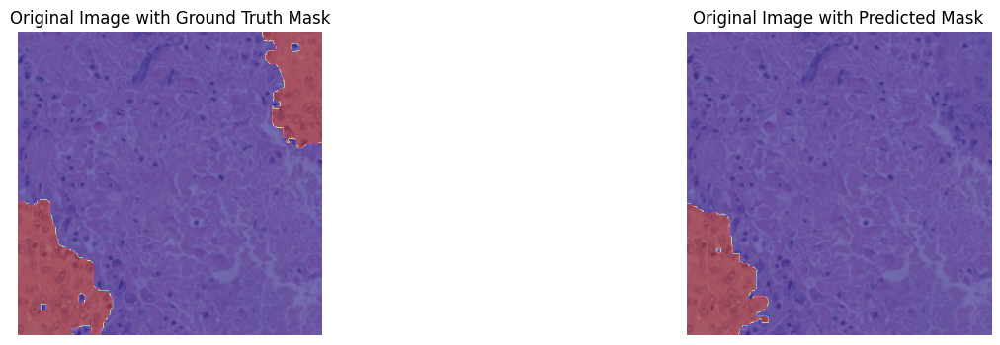

Epoch 77 Loss: 0.3660, Accuracy: 83.51%
Epoch 77 Validation Loss: 0.3666, Validation Accuracy: 82.87%


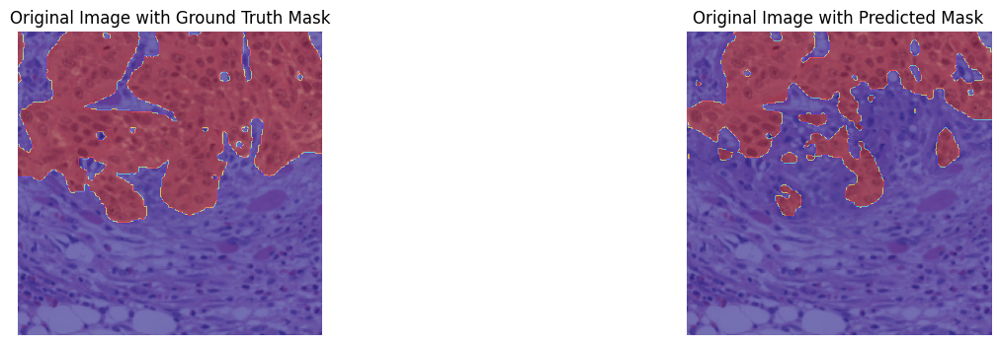

Epoch 78 Loss: 0.3773, Accuracy: 83.27%
Epoch 78 Validation Loss: 0.4815, Validation Accuracy: 78.61%


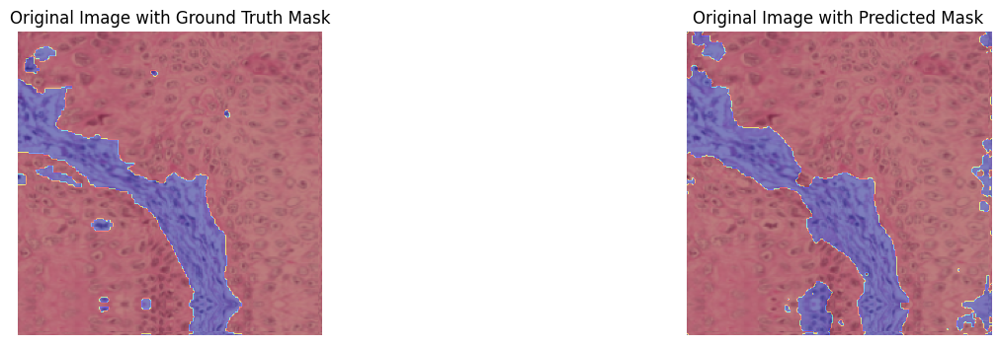

Epoch 79 Loss: 0.3796, Accuracy: 82.69%
Epoch 79 Validation Loss: 0.4586, Validation Accuracy: 76.89%


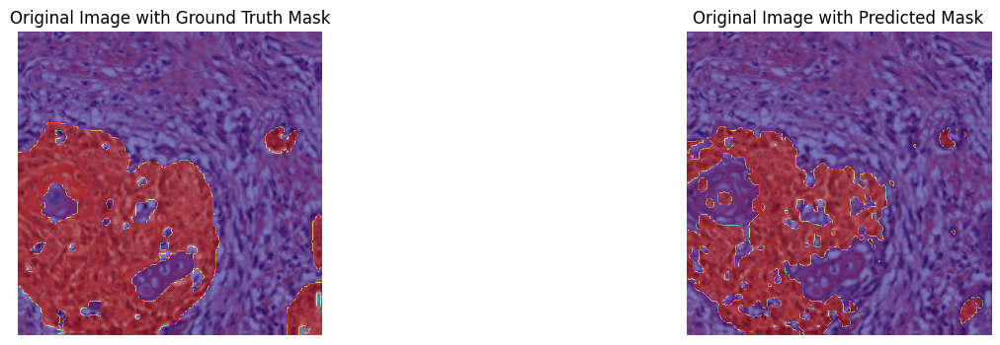

Epoch 80 Loss: 0.3504, Accuracy: 84.37%
Epoch 80 Validation Loss: 0.3860, Validation Accuracy: 83.20%


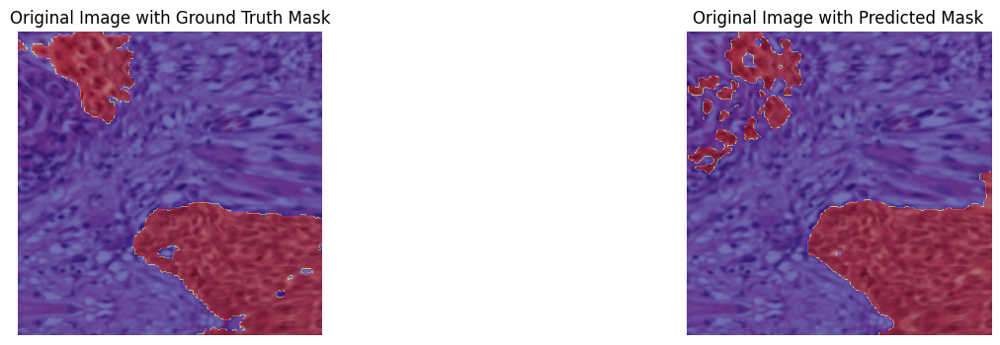

Epoch 81 Loss: 0.3574, Accuracy: 84.39%
Epoch 81 Validation Loss: 0.4854, Validation Accuracy: 79.78%


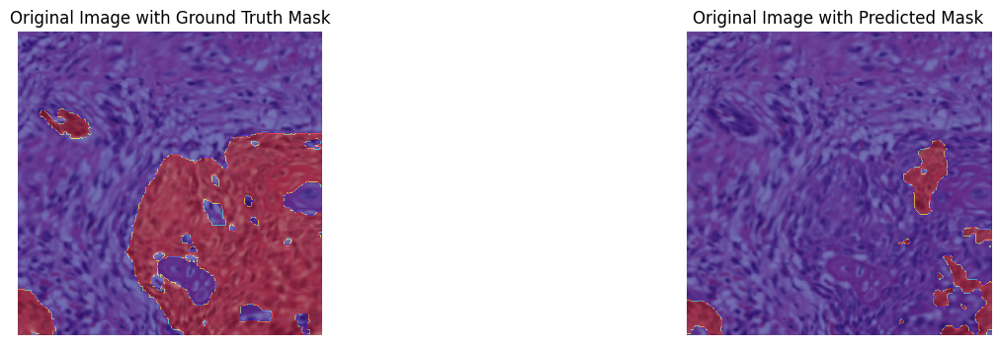

Epoch 82 Loss: 0.3182, Accuracy: 85.92%
Epoch 82 Validation Loss: 0.3156, Validation Accuracy: 86.62%


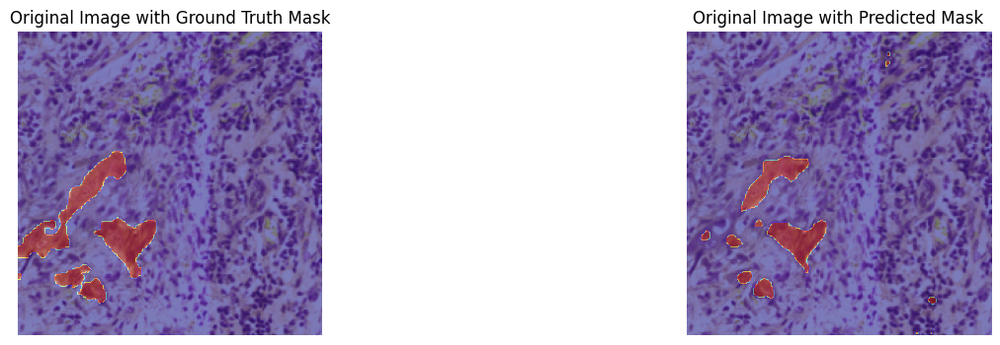

Epoch 83 Loss: 0.3569, Accuracy: 83.79%
Epoch 83 Validation Loss: 0.3975, Validation Accuracy: 82.09%


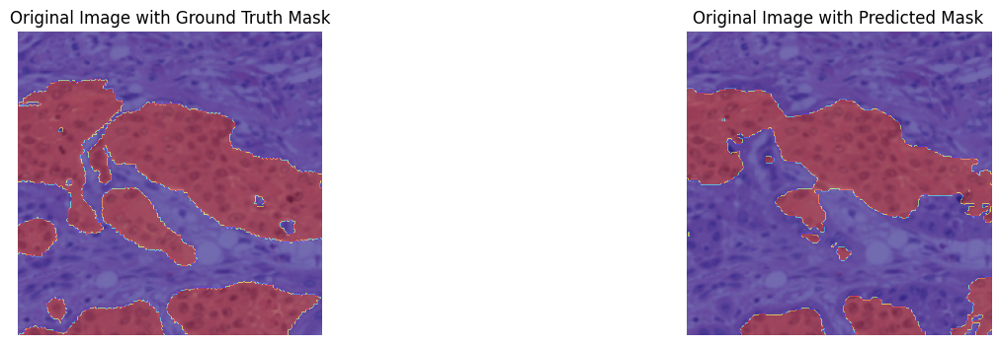

Epoch 84 Loss: 0.3234, Accuracy: 86.09%
Epoch 84 Validation Loss: 0.3868, Validation Accuracy: 83.42%


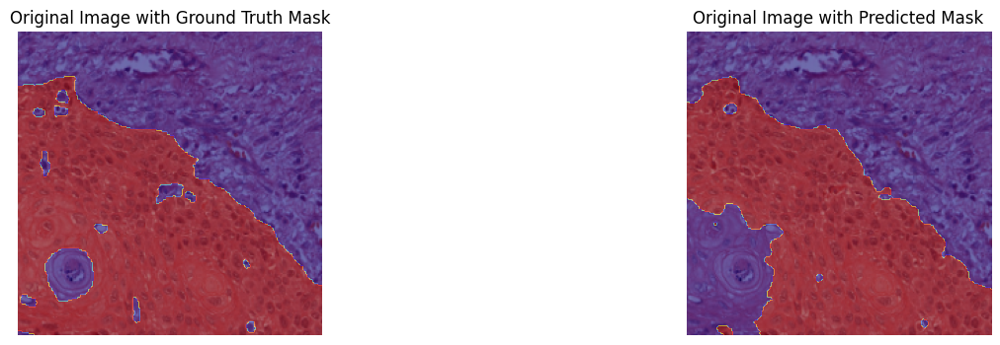

Epoch 85 Loss: 0.3371, Accuracy: 85.09%
Epoch 85 Validation Loss: 1.2693, Validation Accuracy: 59.15%


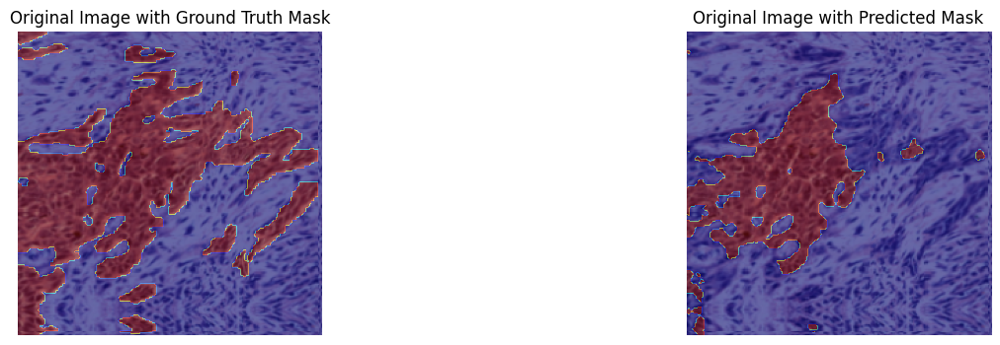

Epoch 86 Loss: 0.3178, Accuracy: 86.10%
Epoch 86 Validation Loss: 0.3487, Validation Accuracy: 84.60%


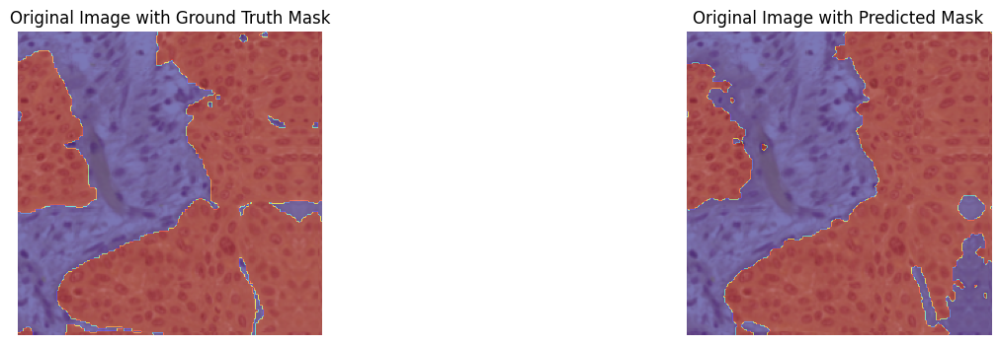

Epoch 87 Loss: 0.3262, Accuracy: 85.59%
Epoch 87 Validation Loss: 1.8327, Validation Accuracy: 57.00%


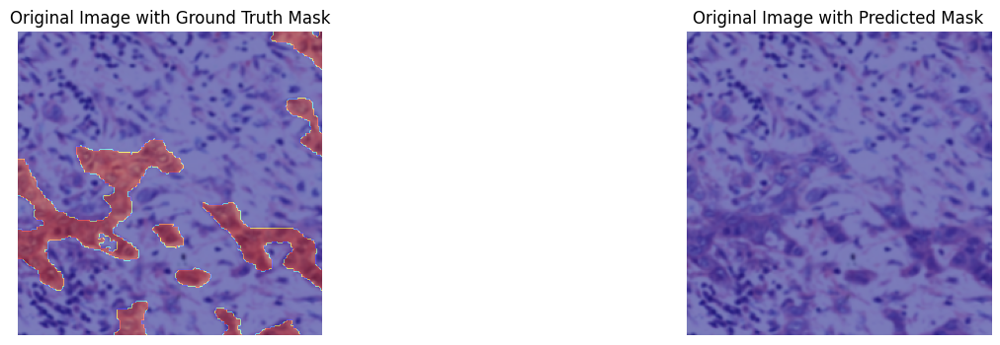

Epoch 88 Loss: 0.3439, Accuracy: 85.24%
Epoch 88 Validation Loss: 0.4779, Validation Accuracy: 78.99%


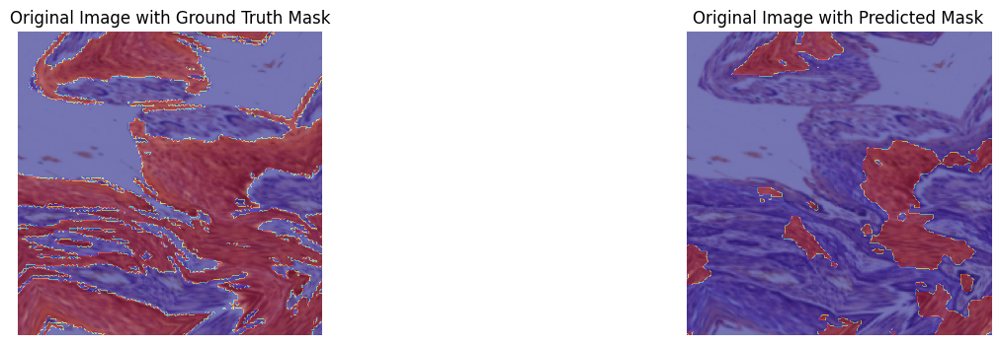

Epoch 89 Loss: 0.3086, Accuracy: 86.41%
Epoch 89 Validation Loss: 0.3191, Validation Accuracy: 86.20%


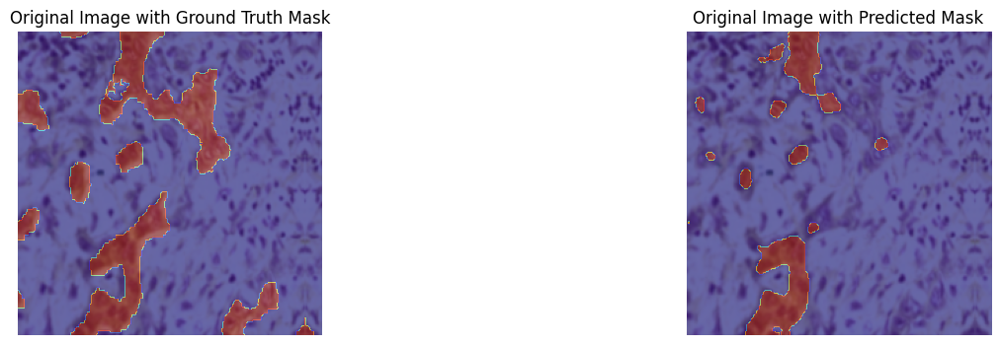

Epoch 90 Loss: 0.3170, Accuracy: 86.07%
Epoch 90 Validation Loss: 1.6670, Validation Accuracy: 63.15%


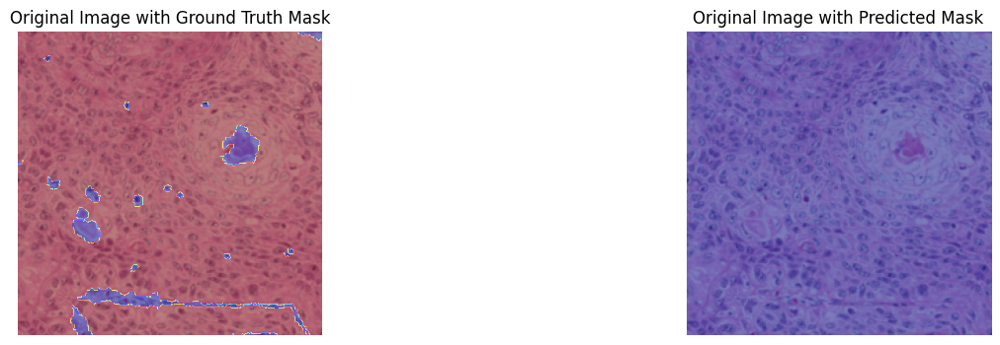

Epoch 91 Loss: 0.3330, Accuracy: 85.15%
Epoch 91 Validation Loss: 0.3444, Validation Accuracy: 84.32%


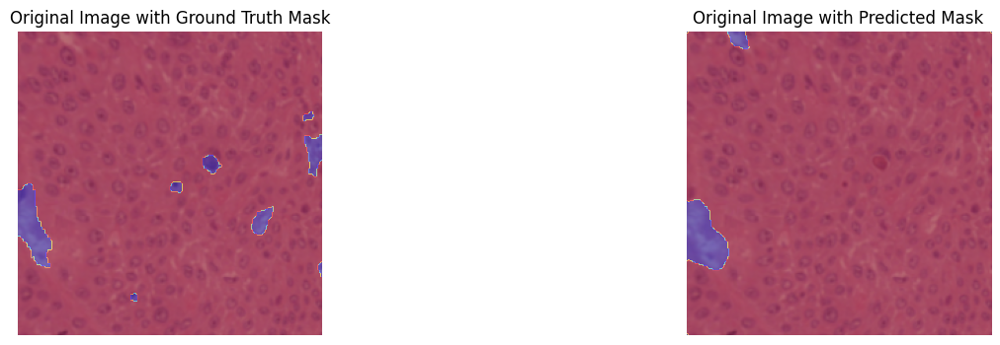

Epoch 92 Loss: 0.3202, Accuracy: 86.11%
Epoch 92 Validation Loss: 0.4165, Validation Accuracy: 81.22%


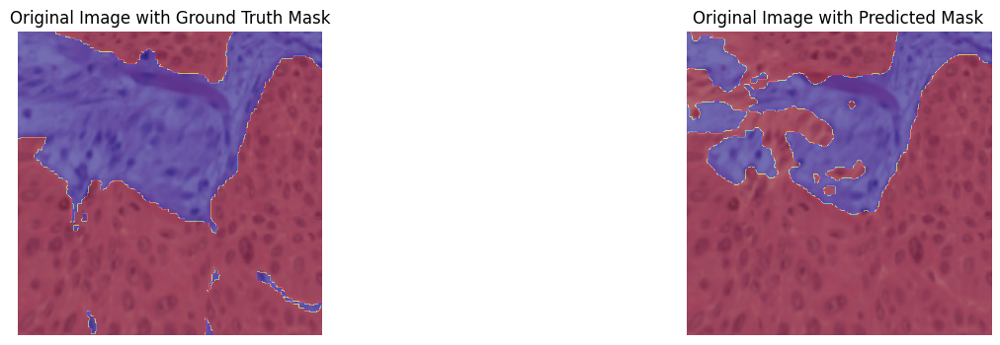

Epoch 93 Loss: 0.3182, Accuracy: 86.38%
Epoch 93 Validation Loss: 0.3572, Validation Accuracy: 84.69%


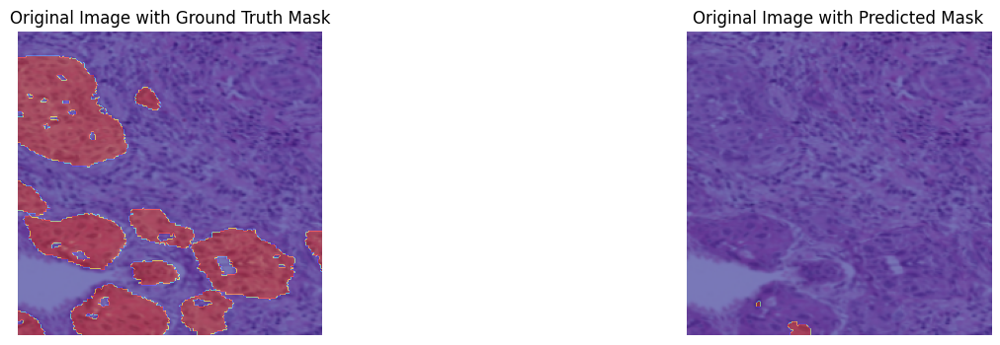

Epoch 94 Loss: 0.3207, Accuracy: 85.48%
Epoch 94 Validation Loss: 0.4077, Validation Accuracy: 80.97%


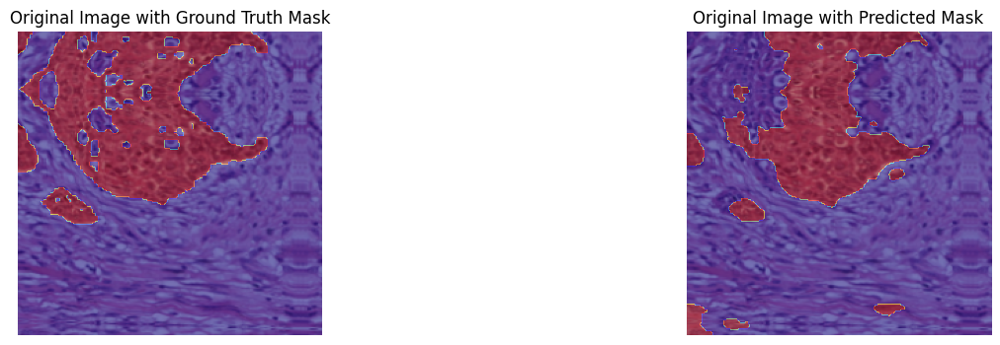

Epoch 95 Loss: 0.3138, Accuracy: 86.33%
Epoch 95 Validation Loss: 0.4162, Validation Accuracy: 82.51%


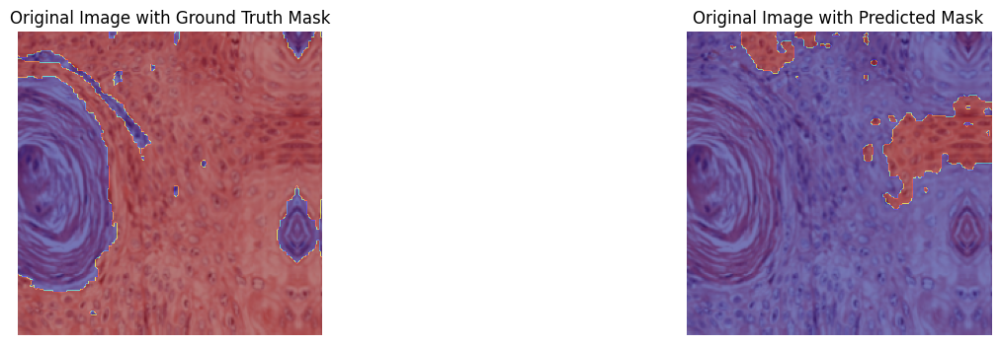

Epoch 96 Loss: 0.3152, Accuracy: 86.28%
Epoch 96 Validation Loss: 0.4118, Validation Accuracy: 81.80%


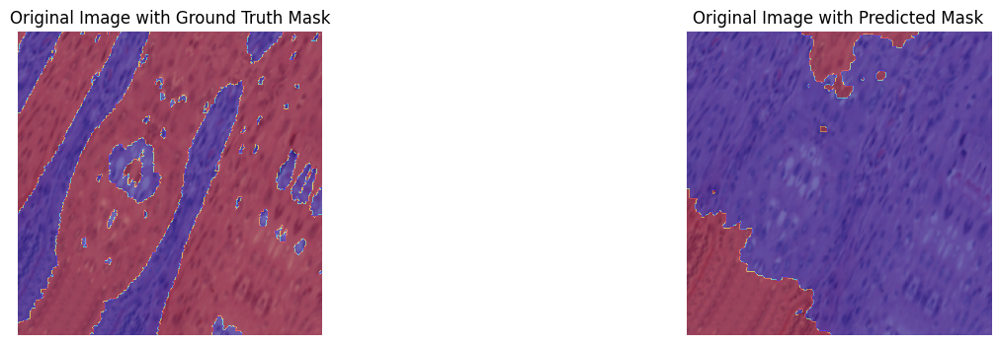

Epoch 97 Loss: 0.3395, Accuracy: 85.20%
Epoch 97 Validation Loss: 0.5582, Validation Accuracy: 75.73%


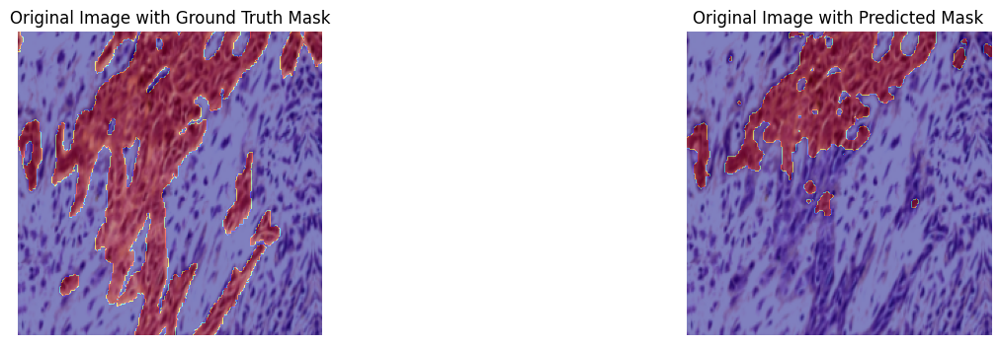

Epoch 98 Loss: 0.3273, Accuracy: 85.65%
Epoch 98 Validation Loss: 0.3658, Validation Accuracy: 84.73%


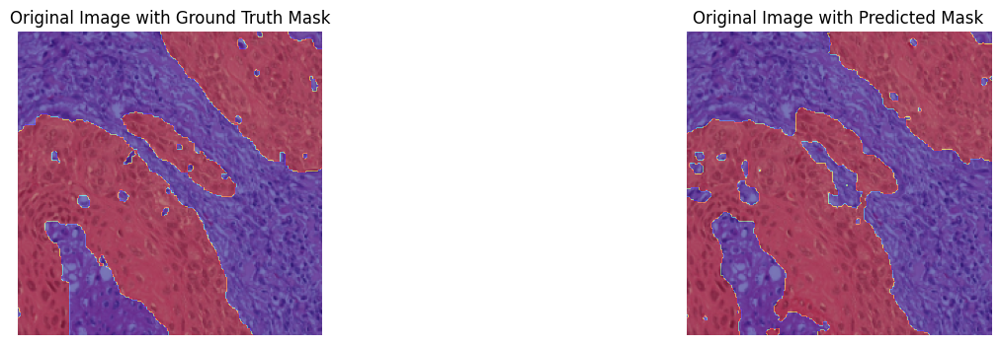

Epoch 99 Loss: 0.3124, Accuracy: 86.65%
Epoch 99 Validation Loss: 0.4322, Validation Accuracy: 79.53%


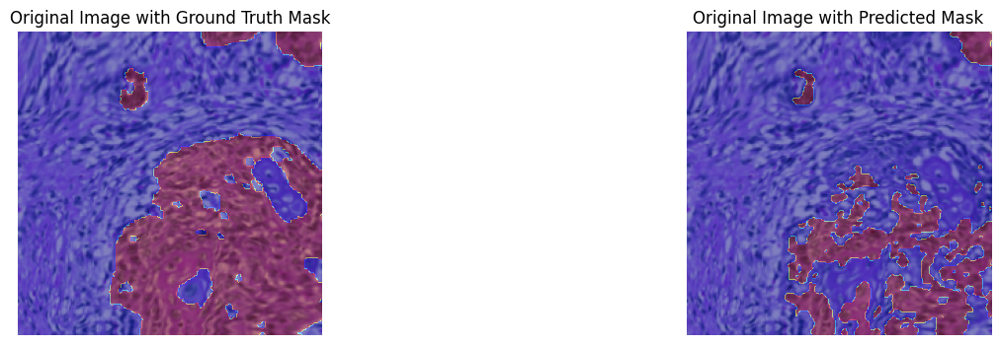

Epoch 100 Loss: 0.3228, Accuracy: 86.21%
Epoch 100 Validation Loss: 0.3523, Validation Accuracy: 85.40%


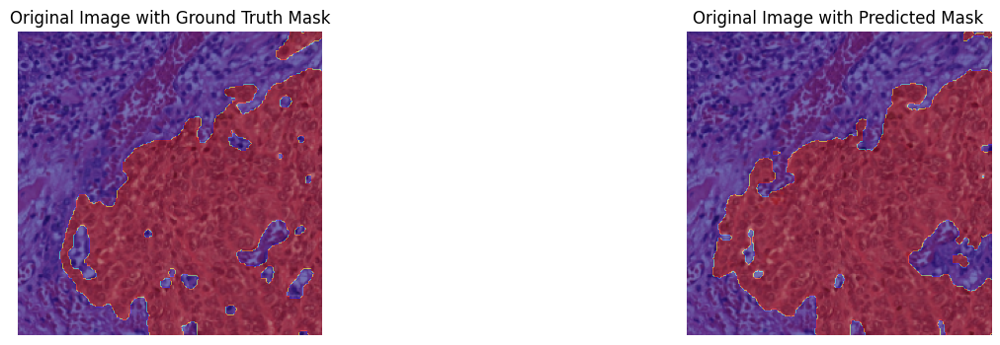

In [3]:
channels = 3
classes = 1
model = UNet(channels, classes)
input_data = torch.randn(1, channels, 256, 256)
output = model(input_data)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
model.to(device)

num_epochs = 100

#training
train_losses = []
accuracies = []
val_losses = []
val_accuracies = []

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct_predictions = 0
    total_samples = 0

    for images, masks in tqdm(train_dataloader, desc=f'Epoch {epoch + 1}/{num_epochs}', leave=False):
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)

        loss = F.binary_cross_entropy(outputs, masks)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        _, predicted = torch.max(outputs, 1)
        binary_predictions = (outputs > 0.5).float()
        correct_predictions += (binary_predictions == masks).sum().item()
        total_samples += masks.numel()

    epoch_loss = running_loss / len(train_dataloader)
    epoch_accuracy = correct_predictions / total_samples

    train_losses.append(epoch_loss)
    accuracies.append(epoch_accuracy)

    print(f"Epoch {epoch + 1} Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy * 100:.2f}%")

    model.eval()
    val_running_loss = 0.0
    val_correct_predictions = 0
    val_total_samples = 0

    with torch.no_grad():
        for val_images, val_masks in test_dataloader:
            val_images, val_masks = val_images.to(device), val_masks.to(device)
            val_outputs = model(val_images)

            val_loss = F.binary_cross_entropy(val_outputs, val_masks)
            val_running_loss += val_loss.item()

            val_binary_predictions = (val_outputs > 0.5).float()
            val_correct_predictions += (val_binary_predictions == val_masks).sum().item()
            val_total_samples += val_masks.numel()

    val_epoch_loss = val_running_loss / len(test_dataloader)
    val_epoch_accuracy = val_correct_predictions / val_total_samples

    val_losses.append(val_epoch_loss)
    val_accuracies.append(val_epoch_accuracy)

    print(f"Epoch {epoch + 1} Validation Loss: {val_epoch_loss:.4f}, Validation Accuracy: {val_epoch_accuracy * 100:.2f}%")
    if(show_images):
        with torch.no_grad():
            for images, masks in test_dataloader:
                images, masks = images.to(device), masks.to(device)

                if torch.any(masks > 0):
                    outputs = model(images)
                    probs = outputs

                    images_np = images.cpu().numpy()
                    masks_np = masks.cpu().numpy()
                    probs_np = probs.cpu().numpy()

                    threshold = 0.5
                    preds_np = (probs_np > threshold).astype(np.uint8)
                    preds_np_squeezed = np.squeeze(preds_np, axis=1) 

                    plt.figure(figsize=(16, 4))

                    plt.subplot(1, 2, 1)
                    plt.imshow(images_np[0].transpose((1, 2, 0)))
                    plt.imshow(masks_np[0, 0], alpha=0.5, cmap='jet')
                    plt.title("Original Image with Ground Truth Mask")
                    plt.axis('off')

                    plt.subplot(1, 2, 2)
                    plt.imshow(images_np[0].transpose((1, 2, 0)))
                    plt.imshow(preds_np_squeezed[0], alpha=0.5, cmap='jet')
                    plt.title("Original Image with Predicted Mask")
                    plt.axis('off')

                    plt.show()

                    break




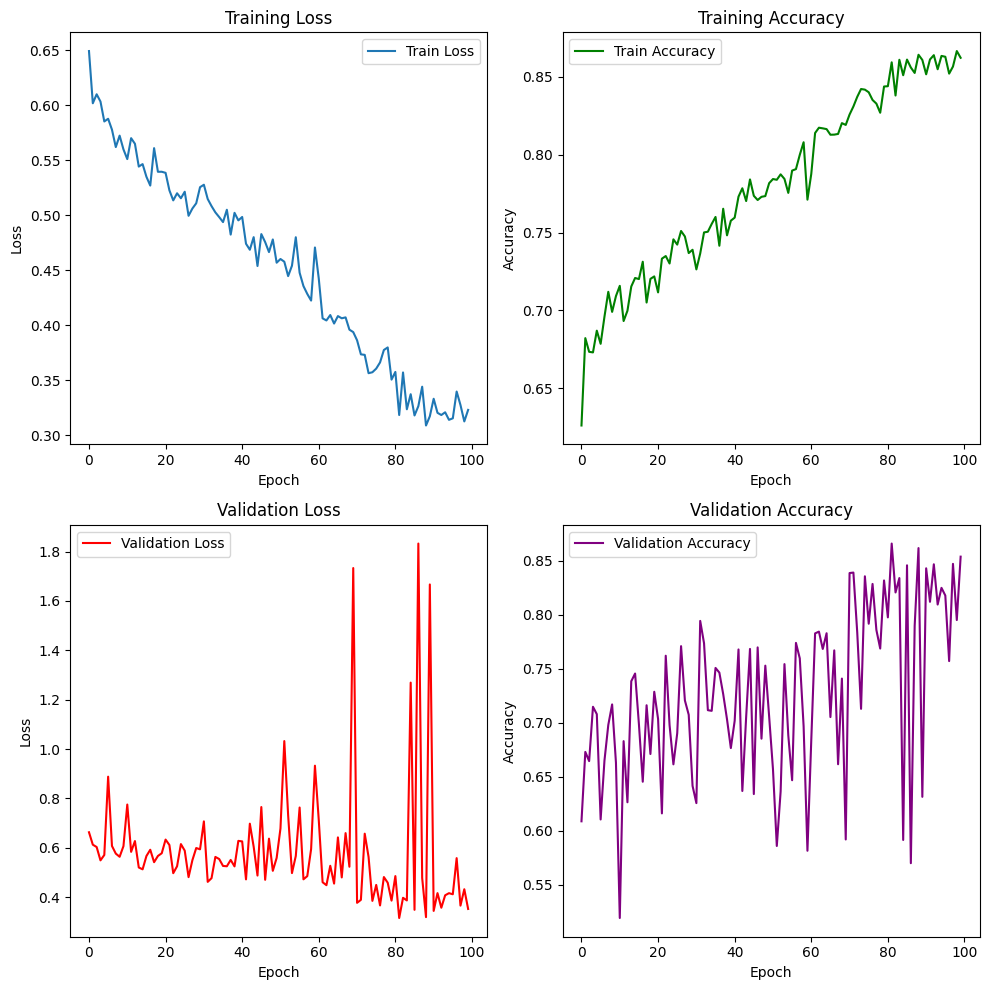

In [4]:
# Plotting training and validation metrics
plt.figure(figsize=(10, 10))

plt.subplot(2, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.legend()

plt.subplot(2, 2, 2)
plt.plot(accuracies, label='Train Accuracy', color='green')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training Accuracy')
plt.legend()

plt.subplot(2, 2, 3)
plt.plot(val_losses, label='Validation Loss', color='red')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Validation Loss')
plt.legend()

plt.subplot(2, 2, 4)
plt.plot(val_accuracies, label='Validation Accuracy', color='purple')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Validation Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

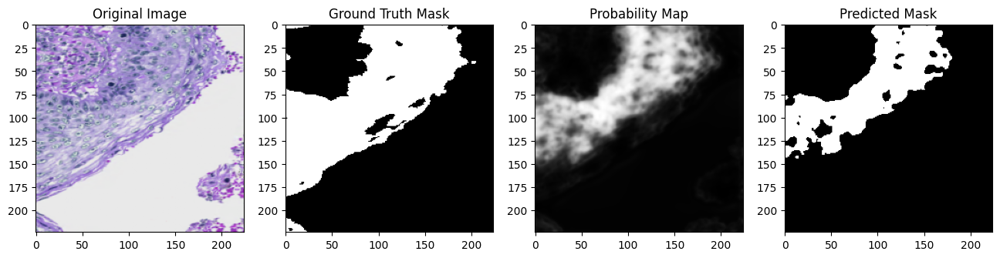

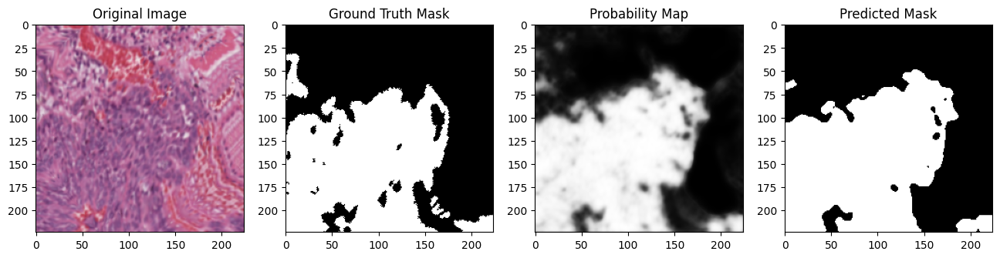

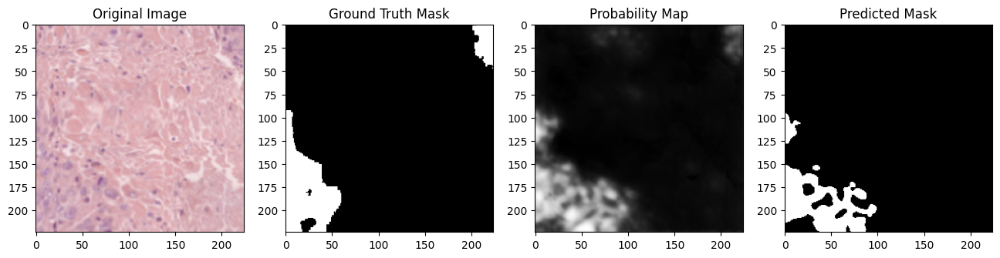

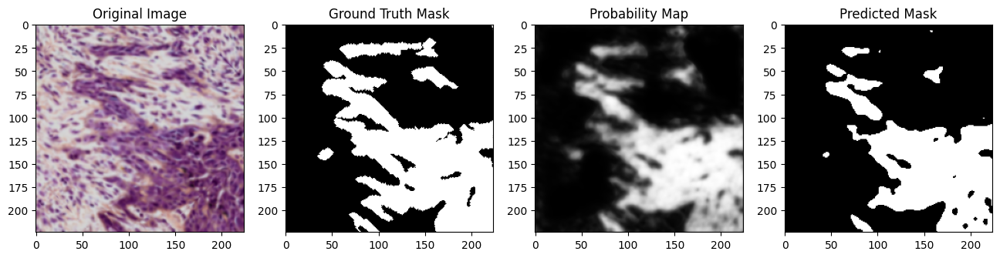

In [5]:
import torch.nn.functional as F
if(show_images):
    with torch.no_grad():
        counter = 0
        for images, masks in test_dataloader:
            images, masks = images.to(device), masks.to(device)
            images_normalized = images

            outputs = model(images_normalized)
            probs = outputs
            #probs = F.softmax(outputs, dim=1)



            images_np = images_normalized.cpu().numpy()
            masks_np = masks.cpu().numpy()
            probs_np = probs.cpu().numpy()

            threshold = 0.5
            preds_np = (probs_np > threshold).astype(np.uint8)
            preds_np_squeezed = np.squeeze(preds_np, axis=1) 


            # print("Shapes:")
            # print("images_np:", images_np.shape)
            # print("masks_np:", masks_np.shape)
            # print("probs_np:", probs_np.shape)
            # print("preds_np:", preds_np.shape)

            # print("Value Ranges:")
            # print("images_np - min:", images_np.min(), "max:", images_np.max())
            # print("masks_np - min:", masks_np.min(), "max:", masks_np.max())
            # print("probs_np - min:", probs_np.min(), "max:", probs_np.max())
            # print("preds_np - min:", preds_np.min(), "max:", preds_np.max())

            plt.figure(figsize=(16, 4))

            plt.subplot(1, 4, 1)
            plt.imshow(images_np[0].transpose((1, 2, 0)))
            plt.title("Original Image")

            plt.subplot(1, 4, 2)
            plt.imshow(masks_np[0, 0], cmap='gray')
            plt.title("Ground Truth Mask")

            plt.subplot(1, 4, 3)
            plt.imshow(probs_np[0, 0], cmap='gray')
            plt.title("Probability Map")

            plt.subplot(1, 4, 4)
            plt.imshow(preds_np_squeezed[0], cmap='gray')
            plt.title("Predicted Mask")

            plt.show()

            counter += 1
            if counter == 10:
                break